## SVR

In [647]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
from pandas.plotting import scatter_matrix

import plotly 
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.dates as mdates
mpl.rc('font', family='Apple SD Gothic Neo')
mpl.rcParams['axes.unicode_minus'] = False

from matplotlib.dates import AutoDateLocator, ConciseDateFormatter

from sklearn.svm import SVR
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler,OneHotEncoder
from sklearn.model_selection import TimeSeriesSplit


import optuna
from optuna.samplers import TPESampler

from joblib import Parallel, delayed,dump
import pickle

In [542]:
## SMAPE
def smape(y_true, y_pred):
    return 100 * np.mean(
        2 * np.abs(y_pred - y_true) / (np.abs(y_true) + np.abs(y_pred))
    )

In [543]:
train_df = pd.read_csv('train2.csv')
valid_df = pd.read_csv('valid2.csv')
test_df = pd.read_csv('test2.csv')

In [ ]:
train_df2 = pd.concat([train_df, valid_df], ignore_index=True)

#건물번호, datetime 기준으로 정렬
train_df3 = train_df2.sort_values(by=['건물번호', 'datetime']).reset_index(drop=True)

In [ ]:
train_df3['august'] = (train_df3['월'] == 8).astype(int)
test_df['august'] = (test_df['월'] == 8).astype(int)

In [546]:
drop_col_for_each = ['datetime','월','일','연면적(m2)','냉방면적(m2)',
                '태양광용량(kW)','ESS저장용량(kWh)','PCS용량(kW)','건물유형','면적비율']

In [ ]:
train_all = train_df3.drop(drop_col_for_each,axis=1)
#valid_all = valid_df.drop(drop_col_for_each,axis=1)
test_all = test_df.drop(drop_col_for_each,axis=1)

In [ ]:
for df in [train_all, test_all]:
    df["weekend"] = df["weekend"].astype("category")
    df['요일'] = df["요일"].astype("category")
    df['시간'] = df["시간"].astype("category")
    df['august'] = df['august'].astype('category')

In [549]:
train_all

,건물번호,기온(°C),강수량(mm),풍속(m/s),습도(%),전력소비량(kWh),시간,요일,weekend,hour_sin,hour_cos,dow_sin,dow_cos,hour_sin_dow_sin,hour_sin_dow_cos,hour_cos_dow_sin,hour_cos_dow_cos,불쾌지수,august
0,1,18.3,0.0,2.6,82.0,5794.80,0,5,1,0.000000,1.000000,-0.974928,-0.222521,-0.000000,-0.000000,-0.974928,-0.222521,17.92380,0
1,1,18.3,0.0,2.7,82.0,5591.85,1,5,1,0.258819,0.965926,-0.974928,-0.222521,-0.252330,-0.057593,-0.941708,-0.214939,17.92380,0
2,1,18.1,0.0,2.6,80.0,5338.17,2,5,1,0.500000,0.866025,-0.974928,-0.222521,-0.487464,-0.111260,-0.844312,-0.192709,17.70400,0
3,1,18.0,0.0,2.6,81.0,4554.42,3,5,1,0.707107,0.707107,-0.974928,-0.222521,-0.689378,-0.157346,-0.689378,-0.157346,17.63425,0
4,1,17.8,0.0,1.3,81.0,3602.25,4,5,1,0.866025,0.500000,-0.974928,-0.222521,-0.844312,-0.192709,-0.487464,-0.111260,17.45515,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187195,100,29.1,0.0,2.8,72.0,2667.72,19,5,1,-0.965926,0.258819,-0.974928,-0.222521,0.941708,0.214939,-0.252330,-0.057593,26.85160,1
187196,100,28.6,0.0,3.2,75.0,1994.88,20,5,1,-0.866025,0.500000,-0.974928,-0.222521,0.844312,0.192709,-0.487464,-0.111260,26.66125,1
187197,100,28.4,0.0,2.5,75.0,2177.76,21,5,1,-0.707107,0.707107,-0.974928,-0.222521,0.689378,0.157346,-0.689378,-0.157346,26.48875,1
187198,100,28.2,0.0,2.4,76.0,2911.32,22,5,1,-0.500000,0.866025,-0.974928,-0.222521,0.487464,0.111260,-0.844312,-0.192709,26.39160,1


---

In [561]:
train_df = pd.read_csv('train2.csv')
valid_df = pd.read_csv('valid2.csv')
test_df = pd.read_csv('test2.csv')

In [562]:
train_df2 = pd.concat([train_df, valid_df], ignore_index=True)

#건물번호, datetime 기준으로 정렬
train_df3 = train_df2.sort_values(by=['건물번호', 'datetime']).reset_index(drop=True)

In [563]:
train_df3['august'] = (train_df3['월'] == 8).astype(int)
test_df['august'] = (test_df['월'] == 8).astype(int)

In [564]:
drop_col_for_each = ['datetime','월','일','연면적(m2)','냉방면적(m2)',
                '태양광용량(kW)','ESS저장용량(kWh)','PCS용량(kW)','건물유형','면적비율','시간','요일']

In [565]:
train_all = train_df3.drop(drop_col_for_each,axis=1)
#valid_all = valid_df.drop(drop_col_for_each,axis=1)
test_all = test_df.drop(drop_col_for_each,axis=1)

In [566]:
train_all

,건물번호,기온(°C),강수량(mm),풍속(m/s),습도(%),전력소비량(kWh),weekend,hour_sin,hour_cos,dow_sin,dow_cos,hour_sin_dow_sin,hour_sin_dow_cos,hour_cos_dow_sin,hour_cos_dow_cos,불쾌지수,august
0,1,18.3,0.0,2.6,82.0,5794.80,1,0.000000,1.000000,-0.974928,-0.222521,-0.000000,-0.000000,-0.974928,-0.222521,17.92380,0
1,1,18.3,0.0,2.7,82.0,5591.85,1,0.258819,0.965926,-0.974928,-0.222521,-0.252330,-0.057593,-0.941708,-0.214939,17.92380,0
2,1,18.1,0.0,2.6,80.0,5338.17,1,0.500000,0.866025,-0.974928,-0.222521,-0.487464,-0.111260,-0.844312,-0.192709,17.70400,0
3,1,18.0,0.0,2.6,81.0,4554.42,1,0.707107,0.707107,-0.974928,-0.222521,-0.689378,-0.157346,-0.689378,-0.157346,17.63425,0
4,1,17.8,0.0,1.3,81.0,3602.25,1,0.866025,0.500000,-0.974928,-0.222521,-0.844312,-0.192709,-0.487464,-0.111260,17.45515,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203995,100,29.1,0.0,4.4,76.0,3276.00,1,-0.965926,0.258819,-0.974928,-0.222521,0.941708,0.214939,-0.252330,-0.057593,27.17280,1
203996,100,28.6,0.0,3.7,74.0,3197.52,1,-0.866025,0.500000,-0.974928,-0.222521,0.844312,0.192709,-0.487464,-0.111260,26.58370,1
203997,100,28.3,0.0,2.9,74.0,3006.60,1,-0.707107,0.707107,-0.974928,-0.222521,0.689378,0.157346,-0.689378,-0.157346,26.32660,1
203998,100,28.0,0.0,1.7,76.0,2649.72,1,-0.500000,0.866025,-0.974928,-0.222521,0.487464,0.111260,-0.844312,-0.192709,26.21800,1


In [583]:
import numpy as np
import optuna
from optuna.samplers import TPESampler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR
import json, os

SAVE_PATH = "svr_poly_CV.json"


# ===== 건물별 튜닝 함수 =====
def tune_building_svr(b_id, n_trials=100, n_splits=4, seed_offset=100):
    """
    - kernel='poly', degree=3 고정
    - 튜닝 파라미터: C, epsilon, coef0
    - 시계열 CV로 SMAPE 최소화
    - 결과를 SAVE_PATH(JSON)에 {건물번호: {best_params, best_value}}로 저장
    """
    print(f"\n=== [건물 {b_id}] SVR(poly, deg=3) 튜닝 시작 ===")

    # 데이터 분리
    bld_train = train_all[train_all["건물번호"] == b_id]
    X_train = bld_train.drop(columns=["건물번호", "전력소비량(kWh)"])
    y_train = bld_train["전력소비량(kWh)"].astype(float)

    # 시계열 CV
    tscv = TimeSeriesSplit(n_splits=n_splits)

    def objective(trial):
        # ——— 하이퍼파라미터 제안 ———
        C = trial.suggest_float("C", 1e-4, 60, log=True)
        epsilon = trial.suggest_float("epsilon", 1e-4, 1.0, log=True)
        coef0 = trial.suggest_float("coef0", 0.0, 10.0)  # poly independent term
        
        # 파이프라인: 결측치/스케일링 + SVR
        pipe = Pipeline(steps=[
            ("scaler", StandardScaler(with_mean=True, with_std=True)),
            ("svr", SVR(
                kernel="poly",
                degree=3,
                C=C,
                epsilon=epsilon,
                coef0=coef0,
                gamma="scale",
                max_iter=-1,     # 무제한 (수렴 시까지); 너무 느리면 적절히 제한
                tol=1e-3
            ))
        ])

        scores = []
        for tr_idx, val_idx in tscv.split(X_train):
            X_tr, X_val = X_train.iloc[tr_idx], X_train.iloc[val_idx]
            y_tr, y_val = y_train.iloc[tr_idx], y_train.iloc[val_idx]

            try:
                pipe.fit(X_tr, y_tr)
                preds = pipe.predict(X_val)
                scores.append(smape(y_val.values, preds))
            except Exception:
                # 수렴 실패나 수치 에러시 큰 페널티
                return float("inf")

        return float(np.mean(scores)) if scores else float("inf")

    sampler = TPESampler(
        seed=int(b_id) + int(seed_offset),
        n_startup_trials=10,
        multivariate=True
    )
    study = optuna.create_study(direction="minimize", sampler=sampler)
    study.optimize(objective, n_trials=n_trials, n_jobs=1)

    # NumPy 타입 → 기본 타입으로 변환
    best_params_clean = {
        k: (float(v) if isinstance(v, (np.floating,)) else
            int(v) if isinstance(v, (np.integer,)) else v)
        for k, v in study.best_params.items()
    }
    result = {
        "best_params": best_params_clean,
        "best_value": float(study.best_value)
    }

    # JSON 병합 저장
    if os.path.exists(SAVE_PATH):
        try:
            with open(SAVE_PATH, "r", encoding="utf-8") as f:
                prev_data = json.load(f)
        except json.JSONDecodeError:
            prev_data = {}
    else:
        prev_data = {}
    prev_data[str(b_id)] = result
    with open(SAVE_PATH, "w", encoding="utf-8") as f:
        json.dump(prev_data, f, indent=2, ensure_ascii=False)

    print(f"=== [건물 {b_id}] 완료 → Best SMAPE: {study.best_value:.4f} ===")
    return int(b_id), best_params_clean, float(study.best_value)


In [584]:
building_ids = train_all["건물번호"].unique()
results = Parallel(n_jobs=4)(delayed(tune_building_svr)(b) for b in building_ids)

for b_id, params, score in results:
    print(f"건물 {b_id} → SMAPE {score:.3f}, params={params}")


=== [건물 1] SVR(poly, deg=3) 튜닝 시작 ===

=== [건물 4] SVR(poly, deg=3) 튜닝 시작 ===

=== [건물 3] SVR(poly, deg=3) 튜닝 시작 ===

=== [건물 2] SVR(poly, deg=3) 튜닝 시작 ===


/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-08-18 05:51:04,401] A new study created in memory with name: no-name-9233f45e-3401-48d8-9137-39171483f50a
[I 2025-08-18 05:51:04,401] A new study created in memory with name: no-name-706de382-d353-4594-95c9-294fc791ec83
/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-08-18 05:51:04,401] A new study created in memory with name: no-name-bb840a5c-7d6a-4882-a7bb-8f61c2a9b236
/opt/anaconda3/lib/python3.13/site-packages/op

=== [건물 1] 완료 → Best SMAPE: 11.6451 ===

=== [건물 5] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:51:22,275] Trial 69 finished with value: 10.586285059375145 and parameters: {'C': 18.39898942494472, 'epsilon': 0.02863445796233064, 'coef0': 4.157428263210765}. Best is trial 61 with value: 10.465645164748809.
[I 2025-08-18 05:51:22,280] Trial 70 finished with value: 7.755166290424946 and parameters: {'C': 9.349344246952553, 'epsilon': 0.002976744999750211, 'coef0': 5.2868465313276145}. Best is trial 64 with value: 7.249002484923706.
[I 2025-08-18 05:51:22,372] Trial 63 finished with value: 5.114184524569868 and parameters: {'C': 37.503914064385505, 'epsilon': 0.02492260805285871, 'coef0': 9.009180135032706}. Best is trial 37 with value: 5.061848546633502.
[I 2025-08-18 05:51:22,373] Trial 1 finished with value: 17.12704422620058 and parameters: {'C': 0.0004080134875592438, 'epsilon': 0.013885456942705541, 'coef0': 0.6368956975025597}. Best is trial 0 with value: 16.945991282484776.
[I 2025-08-18 05:51:22,447] Trial 71 finished with value: 7.941214359024914 and parame

=== [건물 2] 완료 → Best SMAPE: 10.4373 ===

=== [건물 6] SVR(poly, deg=3) 튜닝 시작 ===


/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-08-18 05:51:29,385] A new study created in memory with name: no-name-f65a505f-adfa-48fb-9fbc-44b37b8b7854
[I 2025-08-18 05:51:29,416] Trial 21 finished with value: 5.257656824067999 and parameters: {'C': 56.537295262829225, 'epsilon': 0.015859372521794115, 'coef0': 5.164921255218112}. Best is trial 3 with value: 4.977180849804227.
[I 2025-08-18 05:51:29,478] Trial 97 finished with value: 7.365744362559493 and parameters: {'C': 3.4697693175789848, 'epsilon': 0.004450463172132099, 'coef0': 5.681459394275526}. Best is trial 83 with value: 7.236786130529238.
[I 2025-08-18 05:51:29,489] Trial 87 finished with value: 5.140801367788423 and parameters: {'C': 36.624678531739626, 'epsilon': 0.1778285221248702, 'coef0': 7.592410130876595}. Best is trial 76 with value: 5.060952804874791.
[

=== [건물 4] 완료 → Best SMAPE: 7.2368 ===

=== [건물 7] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:51:30,350] Trial 0 finished with value: 53.750883892551514 and parameters: {'C': 0.0008712320930015051, 'epsilon': 0.10450173732996501, 'coef0': 5.634018486477773}. Best is trial 0 with value: 53.750883892551514.
[I 2025-08-18 05:51:30,469] Trial 89 finished with value: 5.073983963718973 and parameters: {'C': 52.59594092681724, 'epsilon': 0.3690135491936002, 'coef0': 9.198408219753507}. Best is trial 76 with value: 5.060952804874791.
[I 2025-08-18 05:51:30,511] Trial 1 finished with value: 53.68438430826181 and parameters: {'C': 0.002002681368847869, 'epsilon': 0.0023176461945397494, 'coef0': 1.524912269210792}. Best is trial 1 with value: 53.68438430826181.
[I 2025-08-18 05:51:30,551] Trial 24 finished with value: 5.0059184114835755 and parameters: {'C': 7.6842457599279275, 'epsilon': 0.9225209235479664, 'coef0': 9.257326721693568}. Best is trial 23 with value: 4.9028186041032455.
[I 2025-08-18 05:51:30,636] Trial 2 finished with value: 12.481102547850696 and paramete

=== [건물 3] 완료 → Best SMAPE: 5.0610 ===

=== [건물 8] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:51:34,502] Trial 28 finished with value: 53.6732325291955 and parameters: {'C': 0.010144814587714275, 'epsilon': 0.06957685130649906, 'coef0': 0.2667044693268248}. Best is trial 28 with value: 53.6732325291955.
[I 2025-08-18 05:51:34,516] Trial 0 finished with value: 25.289790917759568 and parameters: {'C': 0.002237898975599296, 'epsilon': 0.0001372620524176436, 'coef0': 5.800889403510553}. Best is trial 0 with value: 25.289790917759568.
[I 2025-08-18 05:51:34,635] Trial 29 finished with value: 55.80349961892328 and parameters: {'C': 0.1681777267017219, 'epsilon': 0.0238469225950594, 'coef0': 2.065411624629423}. Best is trial 28 with value: 53.6732325291955.
[I 2025-08-18 05:51:34,653] Trial 1 finished with value: 26.571714967744665 and parameters: {'C': 0.0005572394776419544, 'epsilon': 0.0555860522232807, 'coef0': 6.8367494096451935}. Best is trial 0 with value: 25.289790917759568.
[I 2025-08-18 05:51:35,038] Trial 30 finished with value: 59.785981188562566 and param

=== [건물 7] 완료 → Best SMAPE: 53.6656 ===

=== [건물 9] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:51:45,619] Trial 53 finished with value: 11.988992683623012 and parameters: {'C': 17.588003735265545, 'epsilon': 0.0014613267386433578, 'coef0': 9.024402586337954}. Best is trial 14 with value: 11.734112772792182.
[I 2025-08-18 05:51:45,630] Trial 1 finished with value: 33.172482039326155 and parameters: {'C': 0.0013312221795553191, 'epsilon': 0.12583882545136324, 'coef0': 7.07893441180812}. Best is trial 0 with value: 15.288308386319805.
[I 2025-08-18 05:51:45,636] Trial 31 finished with value: 15.54722269675538 and parameters: {'C': 11.147446864713851, 'epsilon': 0.014979886831511148, 'coef0': 0.1233490621009441}. Best is trial 26 with value: 13.337762360289588.
[I 2025-08-18 05:51:45,766] Trial 2 finished with value: 33.95850597407097 and parameters: {'C': 0.01286730330172203, 'epsilon': 0.7733744142991844, 'coef0': 0.9296837662230706}. Best is trial 0 with value: 15.288308386319805.
[I 2025-08-18 05:51:45,796] Trial 54 finished with value: 12.20592914086123 and par

=== [건물 5] 완료 → Best SMAPE: 4.8841 ===

=== [건물 10] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:51:49,687] Trial 44 finished with value: 13.785122653521505 and parameters: {'C': 43.01435740450824, 'epsilon': 0.00010782336816426282, 'coef0': 0.14734678119468025}. Best is trial 26 with value: 13.337762360289588.
[I 2025-08-18 05:51:49,762] Trial 0 finished with value: 50.14177642462129 and parameters: {'C': 0.0004683878925107291, 'epsilon': 0.04303497222290048, 'coef0': 3.7558898296654384}. Best is trial 0 with value: 50.14177642462129.
[I 2025-08-18 05:51:49,804] Trial 23 finished with value: 14.18840074671369 and parameters: {'C': 21.165380378602702, 'epsilon': 0.016618793032933732, 'coef0': 3.204682612106216}. Best is trial 10 with value: 13.74177898646324.
[I 2025-08-18 05:51:49,900] Trial 1 finished with value: 33.975850457230564 and parameters: {'C': 0.34733651287863415, 'epsilon': 0.05223507349321746, 'coef0': 6.824631292225899}. Best is trial 1 with value: 33.975850457230564.
[I 2025-08-18 05:51:49,976] Trial 24 finished with value: 13.82836748356001 and pa

=== [건물 6] 완료 → Best SMAPE: 11.7189 ===

=== [건물 11] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:51:58,375] Trial 60 finished with value: 13.956536661644153 and parameters: {'C': 49.698072339953605, 'epsilon': 0.0005308842577578268, 'coef0': 0.07636052414600353}. Best is trial 26 with value: 13.337762360289588.
[I 2025-08-18 05:51:58,413] Trial 0 finished with value: 16.94678890078304 and parameters: {'C': 0.3445179589972955, 'epsilon': 0.0004745467652605493, 'coef0': 4.360590193711702}. Best is trial 0 with value: 16.94678890078304.
[I 2025-08-18 05:51:58,413] Trial 62 finished with value: 14.290226813914698 and parameters: {'C': 46.41132960290592, 'epsilon': 0.5664508900682422, 'coef0': 4.578765041872543}. Best is trial 57 with value: 13.682898170421067.
[I 2025-08-18 05:51:58,444] Trial 34 finished with value: 25.48213445596423 and parameters: {'C': 52.45639352509596, 'epsilon': 0.0003325916741755107, 'coef0': 8.433479434778219}. Best is trial 13 with value: 25.437667379769703.
[I 2025-08-18 05:51:58,535] Trial 61 finished with value: 27.45135427691214 and para

=== [건물 9] 완료 → Best SMAPE: 13.6350 ===

=== [건물 12] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:52:06,108] Trial 60 finished with value: 50.0656744465082 and parameters: {'C': 0.0010870219729687235, 'epsilon': 0.018193705744430747, 'coef0': 5.2578910838373885}. Best is trial 58 with value: 25.354317465346092.
[I 2025-08-18 05:52:06,232] Trial 1 finished with value: 19.49246115556054 and parameters: {'C': 0.0002736997085652755, 'epsilon': 0.12815000718576244, 'coef0': 8.327457625618592}. Best is trial 0 with value: 14.447264488363267.
[I 2025-08-18 05:52:06,406] Trial 2 finished with value: 19.506695361594456 and parameters: {'C': 0.00020733654473590303, 'epsilon': 0.18651318083529786, 'coef0': 8.853514580727667}. Best is trial 0 with value: 14.447264488363267.
[I 2025-08-18 05:52:06,417] Trial 61 finished with value: 25.658414511303683 and parameters: {'C': 12.171170905031053, 'epsilon': 0.00043126973882982937, 'coef0': 9.961565010016654}. Best is trial 58 with value: 25.354317465346092.
[I 2025-08-18 05:52:06,644] Trial 3 finished with value: 7.847555272802111 a

=== [건물 10] 완료 → Best SMAPE: 25.3543 ===

=== [건물 13] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:52:18,695] Trial 45 finished with value: 8.569509662190839 and parameters: {'C': 0.4384905830847115, 'epsilon': 0.18270458640070592, 'coef0': 8.284431144414702}. Best is trial 21 with value: 6.679192391207255.
[I 2025-08-18 05:52:18,730] Trial 98 finished with value: 15.419991334048252 and parameters: {'C': 4.672821142686888, 'epsilon': 0.00455484100914135, 'coef0': 0.39487352501225825}. Best is trial 26 with value: 13.337762360289588.
[I 2025-08-18 05:52:18,900] Trial 99 finished with value: 14.535328561784496 and parameters: {'C': 5.0521885033954055, 'epsilon': 0.0004400274384981689, 'coef0': 1.2546956087290058}. Best is trial 26 with value: 13.337762360289588.
/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-08-18 05:52:18,907] A new study created in memory with name: no-name-12825747-0926-410e-b183-3b21e0

=== [건물 8] 완료 → Best SMAPE: 13.3378 ===

=== [건물 14] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:52:19,191] Trial 1 finished with value: 21.275588641691606 and parameters: {'C': 0.06639344643599995, 'epsilon': 0.11533782413320495, 'coef0': 3.6182242914530094}. Best is trial 1 with value: 21.275588641691606.
[I 2025-08-18 05:52:19,223] Trial 1 finished with value: 14.337206158885396 and parameters: {'C': 0.03327558794345351, 'epsilon': 0.0003241238112227331, 'coef0': 5.758578744249331}. Best is trial 0 with value: 10.809744805682467.
[I 2025-08-18 05:52:19,328] Trial 2 finished with value: 25.559999874566678 and parameters: {'C': 0.0005884057450189868, 'epsilon': 0.012211704987483203, 'coef0': 7.2106141346386}. Best is trial 1 with value: 21.275588641691606.
[I 2025-08-18 05:52:19,468] Trial 3 finished with value: 25.834174380480626 and parameters: {'C': 0.0016300308632959813, 'epsilon': 0.0024459046084719296, 'coef0': 3.40596371844602}. Best is trial 1 with value: 21.275588641691606.
[I 2025-08-18 05:52:19,526] Trial 2 finished with value: 10.70198985782752 and pa

=== [건물 12] 완료 → Best SMAPE: 6.6282 ===

=== [건물 15] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:52:37,902] Trial 58 finished with value: 10.467044805736265 and parameters: {'C': 4.194121247665655, 'epsilon': 0.049787892593863674, 'coef0': 5.593071478027953}. Best is trial 17 with value: 10.287460801929274.
[I 2025-08-18 05:52:37,988] Trial 1 finished with value: 14.41141133190898 and parameters: {'C': 0.2151998515819503, 'epsilon': 0.0815618088840795, 'coef0': 1.9054040324856292}. Best is trial 1 with value: 14.41141133190898.
[I 2025-08-18 05:52:38,004] Trial 66 finished with value: 10.637878540754562 and parameters: {'C': 1.2298048487455522, 'epsilon': 0.11396468538451085, 'coef0': 7.0016812010642875}. Best is trial 15 with value: 10.576473793468931.
[I 2025-08-18 05:52:38,135] Trial 2 finished with value: 10.570389219142069 and parameters: {'C': 0.20491020672322, 'epsilon': 0.028626628878515015, 'coef0': 5.439880128145589}. Best is trial 2 with value: 10.570389219142069.
[I 2025-08-18 05:52:38,312] Trial 3 finished with value: 8.742628501419835 and parameters:

=== [건물 13] 완료 → Best SMAPE: 10.5765 ===

=== [건물 16] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:52:46,598] Trial 37 finished with value: 8.638265784511121 and parameters: {'C': 1.2874595074936264, 'epsilon': 0.11704844681486826, 'coef0': 5.046633752504459}. Best is trial 37 with value: 8.638265784511121.
[I 2025-08-18 05:52:46,607] Trial 0 finished with value: 14.769713198025107 and parameters: {'C': 0.014715706166566082, 'epsilon': 0.002482159187859208, 'coef0': 9.286434762699578}. Best is trial 0 with value: 14.769713198025107.
[I 2025-08-18 05:52:46,743] Trial 38 finished with value: 11.540776842042282 and parameters: {'C': 0.18849256647586438, 'epsilon': 0.8544217073186613, 'coef0': 3.7095118957004463}. Best is trial 37 with value: 8.638265784511121.
[I 2025-08-18 05:52:46,746] Trial 1 finished with value: 25.683499803959446 and parameters: {'C': 0.00014735427809322324, 'epsilon': 0.00010232129485970803, 'coef0': 7.839125962574175}. Best is trial 0 with value: 14.769713198025107.
[I 2025-08-18 05:52:46,886] Trial 2 finished with value: 25.861033462901315 and 

=== [건물 14] 완료 → Best SMAPE: 10.2617 ===

=== [건물 17] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:52:50,327] Trial 52 finished with value: 8.834483850225073 and parameters: {'C': 4.378668732294867, 'epsilon': 0.11842620126041795, 'coef0': 5.779123068539555}. Best is trial 37 with value: 8.638265784511121.
[I 2025-08-18 05:52:50,513] Trial 53 finished with value: 8.60374097817171 and parameters: {'C': 0.9085190338815187, 'epsilon': 0.025684252150204794, 'coef0': 8.113685941342919}. Best is trial 53 with value: 8.60374097817171.
[I 2025-08-18 05:52:50,620] Trial 75 finished with value: 12.555768573312497 and parameters: {'C': 9.469567484446152, 'epsilon': 0.08202132792633403, 'coef0': 9.951453697794864}. Best is trial 33 with value: 12.54148653806409.
[I 2025-08-18 05:52:50,727] Trial 54 finished with value: 8.59493195000635 and parameters: {'C': 1.173610174150199, 'epsilon': 0.015764734382273823, 'coef0': 6.569159908459137}. Best is trial 54 with value: 8.59493195000635.
[I 2025-08-18 05:52:50,918] Trial 55 finished with value: 8.592556567810174 and parameters: {'C'

=== [건물 15] 완료 → Best SMAPE: 8.5926 ===

=== [건물 18] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:53:01,107] Trial 0 finished with value: 13.6244951379732 and parameters: {'C': 27.97585393951162, 'epsilon': 0.020727721843242522, 'coef0': 0.5862476907421765}. Best is trial 0 with value: 13.6244951379732.
[I 2025-08-18 05:53:01,372] Trial 87 finished with value: 12.542014459963164 and parameters: {'C': 7.281891819050826, 'epsilon': 0.13597240458414156, 'coef0': 9.880078420081741}. Best is trial 82 with value: 12.528944018832057.
[I 2025-08-18 05:53:01,403] Trial 32 finished with value: 6.980659889579476 and parameters: {'C': 8.302599460789962, 'epsilon': 0.16888844880769885, 'coef0': 7.714850719271764}. Best is trial 21 with value: 6.945336285969627.
[I 2025-08-18 05:53:01,755] Trial 33 finished with value: 7.347559960271981 and parameters: {'C': 29.87213647286004, 'epsilon': 0.0015917022021920168, 'coef0': 2.759534995864272}. Best is trial 21 with value: 6.945336285969627.
[I 2025-08-18 05:53:02,009] Trial 88 finished with value: 12.524199913871556 and parameters: {

=== [건물 11] 완료 → Best SMAPE: 12.5242 ===

=== [건물 19] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:53:07,855] Trial 11 finished with value: 15.371768193854386 and parameters: {'C': 0.5238272942163771, 'epsilon': 0.5223698982653989, 'coef0': 7.418645510805881}. Best is trial 3 with value: 12.404501112338867.
[I 2025-08-18 05:53:07,925] Trial 1 finished with value: 50.69309638866959 and parameters: {'C': 2.2219747956097593, 'epsilon': 0.03336767549128832, 'coef0': 0.5692516540568981}. Best is trial 0 with value: 21.16874251040751.
[I 2025-08-18 05:53:08,030] Trial 12 finished with value: 15.18141965913929 and parameters: {'C': 1.7924387035390388, 'epsilon': 0.951219742166141, 'coef0': 3.6140455354440717}. Best is trial 3 with value: 12.404501112338867.
[I 2025-08-18 05:53:08,077] Trial 2 finished with value: 73.1006664036331 and parameters: {'C': 0.00017665464991761077, 'epsilon': 0.004785705040087901, 'coef0': 9.870615019859947}. Best is trial 0 with value: 21.16874251040751.
[I 2025-08-18 05:53:08,223] Trial 3 finished with value: 73.32221071457889 and parameters: {

=== [건물 17] 완료 → Best SMAPE: 6.9453 ===

=== [건물 20] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:53:31,253] Trial 86 finished with value: 27.019949506592155 and parameters: {'C': 5.208126536486944, 'epsilon': 0.37083165155348746, 'coef0': 1.2870084146992098}. Best is trial 55 with value: 19.284731175133924.
[I 2025-08-18 05:53:31,254] Trial 73 finished with value: 11.991166104537285 and parameters: {'C': 47.06997147374051, 'epsilon': 0.08784511256256744, 'coef0': 1.743840462995879}. Best is trial 60 with value: 11.59216955140964.
[I 2025-08-18 05:53:31,353] Trial 0 finished with value: 2.324676157378005 and parameters: {'C': 0.8266652818538571, 'epsilon': 0.011267698276337343, 'coef0': 6.237057117039342}. Best is trial 0 with value: 2.324676157378005.
[I 2025-08-18 05:53:31,433] Trial 87 finished with value: 23.31611834098905 and parameters: {'C': 3.9516845198790755, 'epsilon': 0.6802783185947766, 'coef0': 2.312846503932539}. Best is trial 55 with value: 19.284731175133924.
[I 2025-08-18 05:53:31,459] Trial 74 finished with value: 13.384307111953902 and parameters

=== [건물 19] 완료 → Best SMAPE: 19.2847 ===

=== [건물 21] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:53:34,506] Trial 84 finished with value: 19.41515876112058 and parameters: {'C': 4.383025055213143, 'epsilon': 0.0012381539265112899, 'coef0': 0.908834235376017}. Best is trial 60 with value: 11.59216955140964.
[I 2025-08-18 05:53:34,586] Trial 1 finished with value: 15.231717360787844 and parameters: {'C': 0.0007550203082877664, 'epsilon': 0.20927268826789866, 'coef0': 4.0791941490448025}. Best is trial 1 with value: 15.231717360787844.
[I 2025-08-18 05:53:34,737] Trial 2 finished with value: 8.662969571651493 and parameters: {'C': 0.16272045478177002, 'epsilon': 0.09596122180375256, 'coef0': 2.4849975557759576}. Best is trial 2 with value: 8.662969571651493.
[I 2025-08-18 05:53:34,972] Trial 85 finished with value: 11.69749430464225 and parameters: {'C': 52.37187519526237, 'epsilon': 0.007525090355704852, 'coef0': 2.5117135262517314}. Best is trial 60 with value: 11.59216955140964.
[I 2025-08-18 05:53:35,375] Trial 2 finished with value: 3.261452287100975 and paramet

=== [건물 18] 완료 → Best SMAPE: 11.5922 ===

=== [건물 22] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:53:41,118] Trial 0 finished with value: 22.09582842100648 and parameters: {'C': 0.0008074629134107897, 'epsilon': 0.06439322405138408, 'coef0': 2.614782663912485}. Best is trial 0 with value: 22.09582842100648.
[I 2025-08-18 05:53:41,263] Trial 1 finished with value: 12.614359749199803 and parameters: {'C': 0.04074417272341929, 'epsilon': 0.0042880620310822865, 'coef0': 6.1154121111339945}. Best is trial 1 with value: 12.614359749199803.
[I 2025-08-18 05:53:41,324] Trial 17 finished with value: 4.633196326305493 and parameters: {'C': 31.798648958780525, 'epsilon': 0.00012076193221192525, 'coef0': 6.416897481791483}. Best is trial 17 with value: 4.633196326305493.
[I 2025-08-18 05:53:41,409] Trial 2 finished with value: 13.860397046958036 and parameters: {'C': 0.23395262452063004, 'epsilon': 0.0007211663970775844, 'coef0': 1.887731000040771}. Best is trial 1 with value: 12.614359749199803.
[I 2025-08-18 05:53:41,573] Trial 3 finished with value: 8.770433005740175 and pa

=== [건물 22] 완료 → Best SMAPE: 8.7270 ===

=== [건물 23] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:54:07,434] Trial 0 finished with value: 22.919726207418247 and parameters: {'C': 1.0575582453651666, 'epsilon': 0.0013949458198611203, 'coef0': 2.268514535642031}. Best is trial 0 with value: 22.919726207418247.
[I 2025-08-18 05:54:07,635] Trial 1 finished with value: 25.293601076260785 and parameters: {'C': 0.15331340258483392, 'epsilon': 0.07548764540205032, 'coef0': 4.23106460124461}. Best is trial 0 with value: 22.919726207418247.
[I 2025-08-18 05:54:08,362] Trial 2 finished with value: 21.228946476370364 and parameters: {'C': 46.45194244085867, 'epsilon': 0.054867977811816314, 'coef0': 4.809319014843609}. Best is trial 2 with value: 21.228946476370364.
[I 2025-08-18 05:54:08,570] Trial 3 finished with value: 28.710637897324762 and parameters: {'C': 0.01843802196672339, 'epsilon': 0.0023589137648150622, 'coef0': 7.290497073840417}. Best is trial 2 with value: 21.228946476370364.
[I 2025-08-18 05:54:08,801] Trial 4 finished with value: 30.47676916377234 and paramete

=== [건물 20] 완료 → Best SMAPE: 2.3230 ===

=== [건물 24] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:54:36,479] Trial 59 finished with value: 20.011435423406688 and parameters: {'C': 12.401130642219739, 'epsilon': 0.015400182603231284, 'coef0': 6.264136360966871}. Best is trial 47 with value: 19.405494092445807.
[I 2025-08-18 05:54:36,497] Trial 0 finished with value: 22.20420312684692 and parameters: {'C': 0.000410071011011818, 'epsilon': 0.0959148693462727, 'coef0': 5.723135366314988}. Best is trial 0 with value: 22.20420312684692.
[I 2025-08-18 05:54:36,734] Trial 1 finished with value: 18.351349185915446 and parameters: {'C': 0.04444131171249181, 'epsilon': 0.0034579890377763683, 'coef0': 2.739893062519525}. Best is trial 1 with value: 18.351349185915446.
[I 2025-08-18 05:54:36,749] Trial 60 finished with value: 20.88383365701652 and parameters: {'C': 0.4299779112048427, 'epsilon': 0.07002341418062373, 'coef0': 8.803547658997731}. Best is trial 47 with value: 19.405494092445807.
[I 2025-08-18 05:54:36,813] Trial 99 finished with value: 6.831329292897668 and parame

=== [건물 16] 완료 → Best SMAPE: 6.7861 ===

=== [건물 25] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:54:36,983] Trial 2 finished with value: 12.100328558537543 and parameters: {'C': 0.7237487574534074, 'epsilon': 0.0038185637296754105, 'coef0': 2.8157289400414234}. Best is trial 2 with value: 12.100328558537543.
[I 2025-08-18 05:54:37,070] Trial 0 finished with value: 26.792085113703532 and parameters: {'C': 0.08471094702304355, 'epsilon': 0.00016987238358013833, 'coef0': 6.275799857910759}. Best is trial 0 with value: 26.792085113703532.
[I 2025-08-18 05:54:37,221] Trial 61 finished with value: 19.682388817537 and parameters: {'C': 7.452454638347242, 'epsilon': 0.7347868420107171, 'coef0': 7.355192195850533}. Best is trial 47 with value: 19.405494092445807.
[I 2025-08-18 05:54:37,243] Trial 3 finished with value: 11.66739674913365 and parameters: {'C': 3.2099186100176182, 'epsilon': 0.024910167926006414, 'coef0': 1.2294635792733721}. Best is trial 3 with value: 11.66739674913365.
[I 2025-08-18 05:54:37,302] Trial 1 finished with value: 39.12692575894246 and parameter

=== [건물 23] 완료 → Best SMAPE: 19.4055 ===

=== [건물 26] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:54:53,057] Trial 0 finished with value: 61.46742580939558 and parameters: {'C': 0.00040522894451194515, 'epsilon': 0.00032551895911202267, 'coef0': 0.8740630845952124}. Best is trial 0 with value: 61.46742580939558.
[I 2025-08-18 05:54:53,131] Trial 29 finished with value: 21.012654328291763 and parameters: {'C': 4.346656288946289, 'epsilon': 0.012993609507525558, 'coef0': 7.282808306526969}. Best is trial 29 with value: 21.012654328291763.
[I 2025-08-18 05:54:53,260] Trial 1 finished with value: 61.343237876257945 and parameters: {'C': 0.0004647855326013157, 'epsilon': 0.09792881042292567, 'coef0': 3.8304572010154567}. Best is trial 1 with value: 61.343237876257945.
[I 2025-08-18 05:54:53,432] Trial 30 finished with value: 21.031736188578005 and parameters: {'C': 3.066469959777495, 'epsilon': 0.004499845678545529, 'coef0': 7.219255422865175}. Best is trial 29 with value: 21.012654328291763.
[I 2025-08-18 05:54:53,458] Trial 2 finished with value: 34.71091684861455 and

=== [건물 21] 완료 → Best SMAPE: 4.5405 ===

=== [건물 27] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:55:07,663] Trial 0 finished with value: 52.54969950579322 and parameters: {'C': 0.10636240596094794, 'epsilon': 0.00014449469299297643, 'coef0': 1.8596531220043622}. Best is trial 0 with value: 52.54969950579322.
[I 2025-08-18 05:55:07,670] Trial 68 finished with value: 20.87380521030582 and parameters: {'C': 1.6525311101856033, 'epsilon': 0.00011329021615732862, 'coef0': 9.10210113763573}. Best is trial 51 with value: 20.852158585931388.
[I 2025-08-18 05:55:07,973] Trial 63 finished with value: 11.043765999306517 and parameters: {'C': 38.52709744659022, 'epsilon': 0.032817298502387265, 'coef0': 0.15195354418052598}. Best is trial 59 with value: 10.966477908752971.
[I 2025-08-18 05:55:07,978] Trial 1 finished with value: 29.89981843300513 and parameters: {'C': 2.9194513918704574, 'epsilon': 0.01616573721719218, 'coef0': 0.8627689908838709}. Best is trial 1 with value: 29.89981843300513.
[I 2025-08-18 05:55:08,002] Trial 69 finished with value: 24.286738145442136 and pa

=== [건물 25] 완료 → Best SMAPE: 20.8118 ===

=== [건물 28] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:55:18,795] Trial 98 finished with value: 10.843390003098728 and parameters: {'C': 47.01724195222452, 'epsilon': 0.0003449499498014841, 'coef0': 0.5812196387509159}. Best is trial 98 with value: 10.843390003098728.
[I 2025-08-18 05:55:18,870] Trial 0 finished with value: 10.159613121380348 and parameters: {'C': 10.175597332004614, 'epsilon': 0.0011287022697628716, 'coef0': 1.31408478173487}. Best is trial 0 with value: 10.159613121380348.
[I 2025-08-18 05:55:18,967] Trial 27 finished with value: 16.76934299487092 and parameters: {'C': 54.82770576419286, 'epsilon': 0.0011520487677324216, 'coef0': 0.9940654022010023}. Best is trial 25 with value: 16.53529509535165.
[I 2025-08-18 05:55:19,007] Trial 99 finished with value: 11.016836948628276 and parameters: {'C': 19.26556617275993, 'epsilon': 0.00019685589595444796, 'coef0': 0.43444784499237366}. Best is trial 98 with value: 10.843390003098728.
/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: Experim

=== [건물 24] 완료 → Best SMAPE: 10.8434 ===

=== [건물 29] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:55:19,283] Trial 2 finished with value: 10.244553052288353 and parameters: {'C': 3.700007755987974, 'epsilon': 0.025454803731371285, 'coef0': 3.3429937148835265}. Best is trial 0 with value: 10.159613121380348.
[I 2025-08-18 05:55:19,359] Trial 1 finished with value: 44.61960434526475 and parameters: {'C': 0.0003092523328381857, 'epsilon': 0.7845441838578812, 'coef0': 5.163392519162776}. Best is trial 0 with value: 15.808613574398198.
[I 2025-08-18 05:55:19,393] Trial 29 finished with value: 17.608173765984866 and parameters: {'C': 1.6878343668779985, 'epsilon': 0.00018793475322446466, 'coef0': 9.843807230008688}. Best is trial 25 with value: 16.53529509535165.
[I 2025-08-18 05:55:19,445] Trial 3 finished with value: 25.668338354084412 and parameters: {'C': 0.000489864214578601, 'epsilon': 0.0017239799475367917, 'coef0': 1.0972378522258008}. Best is trial 0 with value: 10.159613121380348.
[I 2025-08-18 05:55:19,584] Trial 2 finished with value: 12.911848124768891 and p

=== [건물 26] 완료 → Best SMAPE: 24.4520 ===

=== [건물 30] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:55:28,434] Trial 22 finished with value: 12.151701112130349 and parameters: {'C': 45.5918857051141, 'epsilon': 0.00031370511149234325, 'coef0': 0.7915810394661562}. Best is trial 22 with value: 12.151701112130349.
[I 2025-08-18 05:55:28,542] Trial 1 finished with value: 1.7708820134665912 and parameters: {'C': 0.0005332825902347076, 'epsilon': 0.009452143839521048, 'coef0': 9.211278398605247}. Best is trial 1 with value: 1.7708820134665912.
[I 2025-08-18 05:55:28,700] Trial 2 finished with value: 1.1020983525331751 and parameters: {'C': 0.015660371452618057, 'epsilon': 0.00032047828344366764, 'coef0': 9.987508714571527}. Best is trial 2 with value: 1.1020983525331751.
[I 2025-08-18 05:55:28,730] Trial 54 finished with value: 17.544594056232896 and parameters: {'C': 35.28313853339756, 'epsilon': 0.43982974715085144, 'coef0': 8.19965350204527}. Best is trial 44 with value: 16.521072539800137.
[I 2025-08-18 05:55:28,862] Trial 3 finished with value: 1.1566669364278055 and

=== [건물 27] 완료 → Best SMAPE: 16.5211 ===

=== [건물 31] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:55:43,800] Trial 57 finished with value: 12.627878085524355 and parameters: {'C': 28.294156706084262, 'epsilon': 0.001475699936851165, 'coef0': 0.8610141131518401}. Best is trial 53 with value: 11.995373883757328.
[I 2025-08-18 05:55:43,820] Trial 51 finished with value: 1.0725994017939768 and parameters: {'C': 0.03461354156700476, 'epsilon': 0.6326211921311109, 'coef0': 7.2260492875277755}. Best is trial 50 with value: 0.9895056330920158.
[I 2025-08-18 05:55:43,939] Trial 1 finished with value: 15.007231446809767 and parameters: {'C': 0.507581982960974, 'epsilon': 0.057816023419024344, 'coef0': 1.2660930777445367}. Best is trial 0 with value: 10.544188904378505.
[I 2025-08-18 05:55:43,995] Trial 65 finished with value: 10.174122959446365 and parameters: {'C': 0.836190313936189, 'epsilon': 0.0005429516074100748, 'coef0': 7.541927039487027}. Best is trial 42 with value: 10.123291156991.
[I 2025-08-18 05:55:44,035] Trial 52 finished with value: 1.0901887071124774 and par

=== [건물 30] 완료 → Best SMAPE: 0.9813 ===

=== [건물 32] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:55:54,445] Trial 17 finished with value: 12.65059758002212 and parameters: {'C': 0.08093192984474193, 'epsilon': 0.9029422398538944, 'coef0': 8.507795085581247}. Best is trial 14 with value: 9.136224705157035.
[I 2025-08-18 05:55:54,450] Trial 0 finished with value: 19.791400313447237 and parameters: {'C': 3.252226911855464, 'epsilon': 0.003346402432623359, 'coef0': 8.286376417073244}. Best is trial 0 with value: 19.791400313447237.
[I 2025-08-18 05:55:54,538] Trial 95 finished with value: 10.158611706310198 and parameters: {'C': 0.7309161148987413, 'epsilon': 0.0005743555430079301, 'coef0': 6.509254340375607}. Best is trial 42 with value: 10.123291156991.
[I 2025-08-18 05:55:54,560] Trial 81 finished with value: 11.96949567405064 and parameters: {'C': 57.53443328306229, 'epsilon': 0.0009196992151944455, 'coef0': 0.6284309348711037}. Best is trial 66 with value: 11.867861584050067.
[I 2025-08-18 05:55:54,639] Trial 1 finished with value: 20.253520988053886 and paramete

=== [건물 28] 완료 → Best SMAPE: 10.1233 ===

=== [건물 33] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:55:55,600] Trial 1 finished with value: 41.82220620630817 and parameters: {'C': 0.0006635971976588071, 'epsilon': 0.005715740942334629, 'coef0': 7.3790283992520305}. Best is trial 0 with value: 41.672091115005614.
[I 2025-08-18 05:55:55,640] Trial 21 finished with value: 9.122247912486417 and parameters: {'C': 2.8287187083289917, 'epsilon': 0.00045042825978527413, 'coef0': 7.1108074460337765}. Best is trial 21 with value: 9.122247912486417.
[I 2025-08-18 05:55:55,748] Trial 2 finished with value: 41.71623483479623 and parameters: {'C': 0.0014806242662465103, 'epsilon': 0.0017564215809177217, 'coef0': 5.5813070444282085}. Best is trial 0 with value: 41.672091115005614.
[I 2025-08-18 05:55:55,941] Trial 86 finished with value: 12.664945972257929 and parameters: {'C': 37.68417596384744, 'epsilon': 0.0006088128849403658, 'coef0': 2.719054872989636}. Best is trial 66 with value: 11.867861584050067.
[I 2025-08-18 05:55:56,007] Trial 22 finished with value: 9.113621914277056 

=== [건물 29] 완료 → Best SMAPE: 11.8679 ===

=== [건물 34] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:56:00,827] Trial 14 finished with value: 18.918567135929557 and parameters: {'C': 11.52975449454891, 'epsilon': 0.0003707841416916823, 'coef0': 6.342392160416447}. Best is trial 2 with value: 18.377295333846625.
[I 2025-08-18 05:56:00,857] Trial 23 finished with value: 27.66016696522781 and parameters: {'C': 24.515599156552344, 'epsilon': 0.00010719759513734648, 'coef0': 1.4789027872326916}. Best is trial 14 with value: 27.17804673749646.
[I 2025-08-18 05:56:00,869] Trial 0 finished with value: 9.942850494425102 and parameters: {'C': 4.879921972646771, 'epsilon': 0.00618097489141916, 'coef0': 6.277456560604852}. Best is trial 0 with value: 9.942850494425102.
[I 2025-08-18 05:56:00,990] Trial 15 finished with value: 60.30324670774906 and parameters: {'C': 0.018512442114986725, 'epsilon': 0.3894335164271823, 'coef0': 2.2441851434215954}. Best is trial 2 with value: 18.377295333846625.
[I 2025-08-18 05:56:01,112] Trial 1 finished with value: 8.819490879908864 and paramete

=== [건물 33] 완료 → Best SMAPE: 27.0155 ===

=== [건물 35] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:56:19,687] Trial 0 finished with value: 0.6436236691154601 and parameters: {'C': 0.6626110219811615, 'epsilon': 0.002045402588410209, 'coef0': 1.9539817561257988}. Best is trial 0 with value: 0.6436236691154601.
[I 2025-08-18 05:56:19,723] Trial 60 finished with value: 8.298656455499774 and parameters: {'C': 58.705720197064984, 'epsilon': 0.901374813548427, 'coef0': 8.251663260106424}. Best is trial 45 with value: 8.259790213108516.
[I 2025-08-18 05:56:19,852] Trial 45 finished with value: 17.442715826085596 and parameters: {'C': 45.53375268863736, 'epsilon': 0.0005482418911522178, 'coef0': 1.7913500337246333}. Best is trial 35 with value: 17.32837917864438.
[I 2025-08-18 05:56:19,882] Trial 61 finished with value: 45.50969470804339 and parameters: {'C': 0.11626989443985673, 'epsilon': 0.619189815951859, 'coef0': 2.216162347520566}. Best is trial 45 with value: 8.259790213108516.
[I 2025-08-18 05:56:19,961] Trial 1 finished with value: 0.49997245080207275 and parameter

=== [건물 34] 완료 → Best SMAPE: 8.2598 ===

=== [건물 36] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:56:32,137] Trial 0 finished with value: 2.863982945082677 and parameters: {'C': 0.0007679003355734433, 'epsilon': 0.0003914455081235865, 'coef0': 2.134618842296404}. Best is trial 0 with value: 2.863982945082677.
[I 2025-08-18 05:56:32,289] Trial 1 finished with value: 2.8488067985824985 and parameters: {'C': 0.0007598012900169139, 'epsilon': 0.0009295768956972554, 'coef0': 3.546904636393595}. Best is trial 1 with value: 2.8488067985824985.
[I 2025-08-18 05:56:32,336] Trial 86 finished with value: 17.370752643837672 and parameters: {'C': 52.22388812679729, 'epsilon': 0.09587718149664373, 'coef0': 2.4648517121474307}. Best is trial 67 with value: 17.290896993078903.
[I 2025-08-18 05:56:32,362] Trial 23 finished with value: 0.4779990643309674 and parameters: {'C': 1.0066030395066792, 'epsilon': 0.9274321858521068, 'coef0': 7.803369967737854}. Best is trial 23 with value: 0.4779990643309674.
[I 2025-08-18 05:56:32,440] Trial 2 finished with value: 1.5973434743655577 and p

=== [건물 32] 완료 → Best SMAPE: 17.2909 ===

=== [건물 37] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:56:36,416] Trial 34 finished with value: 0.4810970045377413 and parameters: {'C': 0.8147737010647041, 'epsilon': 0.03914473355071907, 'coef0': 6.993577714803675}. Best is trial 27 with value: 0.47795390401506077.
[I 2025-08-18 05:56:36,494] Trial 13 finished with value: 1.0407147261056209 and parameters: {'C': 0.4068101502364771, 'epsilon': 0.0005551558295194512, 'coef0': 3.8097261710077053}. Best is trial 13 with value: 1.0407147261056209.
[I 2025-08-18 05:56:36,658] Trial 14 finished with value: 1.1378959600346947 and parameters: {'C': 0.40552091844734783, 'epsilon': 0.0002860414309951927, 'coef0': 3.1024485740603276}. Best is trial 13 with value: 1.0407147261056209.
[I 2025-08-18 05:56:36,673] Trial 35 finished with value: 0.48067293706941333 and parameters: {'C': 1.134101118586593, 'epsilon': 0.02299640611655476, 'coef0': 6.637846804241227}. Best is trial 27 with value: 0.47795390401506077.
[I 2025-08-18 05:56:36,728] Trial 75 finished with value: 9.11008296340787 

=== [건물 36] 완료 → Best SMAPE: 0.9414 ===

=== [건물 38] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:56:55,137] Trial 81 finished with value: 0.4810111009892484 and parameters: {'C': 1.074088791763216, 'epsilon': 0.168892904596376, 'coef0': 6.740975598346458}. Best is trial 27 with value: 0.47795390401506077.
[I 2025-08-18 05:56:55,181] Trial 0 finished with value: 7.786861980650621 and parameters: {'C': 2.137041343681594, 'epsilon': 0.06620952101734388, 'coef0': 3.240275277438762}. Best is trial 0 with value: 7.786861980650621.
[I 2025-08-18 05:56:55,427] Trial 91 finished with value: 9.772522249802451 and parameters: {'C': 31.340934829565377, 'epsilon': 0.0008317430004386957, 'coef0': 5.923648061368389}. Best is trial 75 with value: 9.11008296340787.
[I 2025-08-18 05:56:55,471] Trial 82 finished with value: 0.481769573399549 and parameters: {'C': 1.5730444070721863, 'epsilon': 0.18114365764899168, 'coef0': 6.743456504765808}. Best is trial 27 with value: 0.47795390401506077.
[I 2025-08-18 05:56:55,495] Trial 1 finished with value: 6.683622549180459 and parameters: {

=== [건물 31] 완료 → Best SMAPE: 9.1101 ===

=== [건물 39] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:56:59,503] Trial 97 finished with value: 0.4796888572231347 and parameters: {'C': 1.492770998697633, 'epsilon': 0.9414999609789387, 'coef0': 7.0362648859216375}. Best is trial 27 with value: 0.47795390401506077.
[I 2025-08-18 05:56:59,564] Trial 0 finished with value: 9.045140423607577 and parameters: {'C': 0.06868389780514264, 'epsilon': 0.1030337159739388, 'coef0': 9.342233418998186}. Best is trial 0 with value: 9.045140423607577.
[I 2025-08-18 05:56:59,580] Trial 56 finished with value: 9.16743812667429 and parameters: {'C': 51.54560975490297, 'epsilon': 0.0037357620693091154, 'coef0': 3.0937072169186597}. Best is trial 35 with value: 9.125235624249083.
[I 2025-08-18 05:56:59,880] Trial 1 finished with value: 7.9803939343162655 and parameters: {'C': 34.75546252576775, 'epsilon': 0.00042923177663630325, 'coef0': 1.659819202919941}. Best is trial 1 with value: 7.9803939343162655.
[I 2025-08-18 05:57:00,009] Trial 57 finished with value: 9.124014572374373 and parameter

=== [건물 35] 완료 → Best SMAPE: 0.4780 ===

=== [건물 40] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:57:00,655] Trial 6 finished with value: 7.551598282657187 and parameters: {'C': 0.23502042814507576, 'epsilon': 0.004696070263753475, 'coef0': 9.715465914103454}. Best is trial 6 with value: 7.551598282657187.
[I 2025-08-18 05:57:00,732] Trial 1 finished with value: 49.05183007528785 and parameters: {'C': 0.005171156170297254, 'epsilon': 0.0001018295933574016, 'coef0': 3.2063765238554307}. Best is trial 0 with value: 43.633343847155885.
[I 2025-08-18 05:57:00,810] Trial 7 finished with value: 23.823323511188626 and parameters: {'C': 0.008672897183519145, 'epsilon': 0.010967993828274413, 'coef0': 4.370743841279564}. Best is trial 6 with value: 7.551598282657187.
[I 2025-08-18 05:57:00,884] Trial 2 finished with value: 50.78271157866489 and parameters: {'C': 0.0003422558599341621, 'epsilon': 0.02317994698961679, 'coef0': 1.9194662937621854}. Best is trial 0 with value: 43.633343847155885.
[I 2025-08-18 05:57:00,966] Trial 8 finished with value: 12.693071156232996 and par

=== [건물 37] 완료 → Best SMAPE: 9.1240 ===

=== [건물 41] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:57:14,569] Trial 19 finished with value: 14.25151703103823 and parameters: {'C': 1.4086952222136877, 'epsilon': 0.002194726316362789, 'coef0': 9.725065747236071}. Best is trial 11 with value: 13.036055305256639.
[I 2025-08-18 05:57:14,724] Trial 50 finished with value: 7.288584906706951 and parameters: {'C': 0.575474199275547, 'epsilon': 0.000344552608515714, 'coef0': 9.99202040142505}. Best is trial 48 with value: 7.275911725328979.
[I 2025-08-18 05:57:14,752] Trial 20 finished with value: 21.855885869715852 and parameters: {'C': 0.20216777631582436, 'epsilon': 0.012817846761158113, 'coef0': 4.027651831755069}. Best is trial 11 with value: 13.036055305256639.
[I 2025-08-18 05:57:14,962] Trial 0 finished with value: 2.922642095445568 and parameters: {'C': 19.989046633572055, 'epsilon': 0.012290784117619726, 'coef0': 0.4303308197223432}. Best is trial 0 with value: 2.922642095445568.
[I 2025-08-18 05:57:15,044] Trial 51 finished with value: 7.58450715673055 and paramete

=== [건물 39] 완료 → Best SMAPE: 7.2759 ===

=== [건물 42] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:57:26,618] Trial 77 finished with value: 7.108460728406398 and parameters: {'C': 24.460195170416583, 'epsilon': 0.0012426781053724342, 'coef0': 1.4989812815664512}. Best is trial 67 with value: 6.641522015439226.
[I 2025-08-18 05:57:26,859] Trial 0 finished with value: 6.063931541773982 and parameters: {'C': 16.30226421264026, 'epsilon': 0.017030607623778213, 'coef0': 6.559847055064072}. Best is trial 0 with value: 6.063931541773982.
[I 2025-08-18 05:57:27,005] Trial 78 finished with value: 7.166907080403495 and parameters: {'C': 12.65011846301285, 'epsilon': 0.0028471815241746814, 'coef0': 3.386863179726334}. Best is trial 67 with value: 6.641522015439226.
[I 2025-08-18 05:57:27,034] Trial 1 finished with value: 6.120508581550634 and parameters: {'C': 6.458709252292094, 'epsilon': 0.0006302846771081399, 'coef0': 1.2725425751534192}. Best is trial 0 with value: 6.063931541773982.
[I 2025-08-18 05:57:27,191] Trial 79 finished with value: 8.541546200892933 and parameters

=== [건물 38] 완료 → Best SMAPE: 6.6415 ===

=== [건물 43] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:57:38,759] Trial 0 finished with value: 2.4223139945735443 and parameters: {'C': 1.8317228122127927, 'epsilon': 0.0022899128948797648, 'coef0': 4.680901008733496}. Best is trial 0 with value: 2.4223139945735443.
[I 2025-08-18 05:57:38,927] Trial 1 finished with value: 2.5519051973484292 and parameters: {'C': 0.028156455032973437, 'epsilon': 0.018761970774296, 'coef0': 8.81280858162879}. Best is trial 0 with value: 2.4223139945735443.
[I 2025-08-18 05:57:39,002] Trial 42 finished with value: 5.706253591651034 and parameters: {'C': 2.782515587380201, 'epsilon': 0.5440244941532988, 'coef0': 8.951966138927396}. Best is trial 34 with value: 5.698909495043353.
[I 2025-08-18 05:57:39,087] Trial 2 finished with value: 2.985968044568863 and parameters: {'C': 0.00015542233029135403, 'epsilon': 0.00010842659664145819, 'coef0': 1.9923775690534407}. Best is trial 0 with value: 2.4223139945735443.
[I 2025-08-18 05:57:39,186] Trial 43 finished with value: 6.029842008366325 and parame

=== [건물 42] 완료 → Best SMAPE: 5.6989 ===

=== [건물 44] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:57:55,313] Trial 57 finished with value: 2.4012582707345116 and parameters: {'C': 2.498797131308697, 'epsilon': 0.04547482121771615, 'coef0': 1.5716336194200524}. Best is trial 13 with value: 2.3284645226151053.
[I 2025-08-18 05:57:55,439] Trial 1 finished with value: 25.535845775886834 and parameters: {'C': 0.001006087746308046, 'epsilon': 0.06989178208976814, 'coef0': 5.079745153204937}. Best is trial 1 with value: 25.535845775886834.
[I 2025-08-18 05:57:55,526] Trial 58 finished with value: 2.461951805901499 and parameters: {'C': 52.29336635232659, 'epsilon': 0.011471124427201962, 'coef0': 0.1194951708930414}. Best is trial 13 with value: 2.3284645226151053.
[I 2025-08-18 05:57:55,606] Trial 2 finished with value: 12.410257607382398 and parameters: {'C': 0.04491843491650738, 'epsilon': 0.16963079266098108, 'coef0': 6.799571769779691}. Best is trial 2 with value: 12.410257607382398.
[I 2025-08-18 05:57:55,695] Trial 48 finished with value: 2.961565102049257 and param

=== [건물 43] 완료 → Best SMAPE: 2.3228 ===

=== [건물 45] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:58:04,816] Trial 1 finished with value: 65.90393930391637 and parameters: {'C': 0.0002912985030603225, 'epsilon': 0.040647160713514034, 'coef0': 7.707390295296226}. Best is trial 0 with value: 65.2185370635611.
[I 2025-08-18 05:58:04,983] Trial 2 finished with value: 30.561951942595414 and parameters: {'C': 0.2858518178148564, 'epsilon': 0.002026442330224808, 'coef0': 6.975761529231957}. Best is trial 2 with value: 30.561951942595414.
[I 2025-08-18 05:58:05,152] Trial 3 finished with value: 52.0697371539734 and parameters: {'C': 0.07280740622588136, 'epsilon': 0.6207168124898337, 'coef0': 5.726953776659131}. Best is trial 2 with value: 30.561951942595414.
[I 2025-08-18 05:58:05,315] Trial 4 finished with value: 66.0289941802355 and parameters: {'C': 0.0010148972763692461, 'epsilon': 0.00023376266089919723, 'coef0': 0.6841918409284831}. Best is trial 2 with value: 30.561951942595414.
[I 2025-08-18 05:58:05,443] Trial 21 finished with value: 8.351760487323945 and paramet

=== [건물 41] 완료 → Best SMAPE: 1.3102 ===

=== [건물 46] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:58:14,106] Trial 0 finished with value: 17.863166914075883 and parameters: {'C': 0.07553559527141122, 'epsilon': 0.029897017173221855, 'coef0': 2.9982060686947296}. Best is trial 0 with value: 17.863166914075883.
[I 2025-08-18 05:58:14,185] Trial 44 finished with value: 8.278397306162365 and parameters: {'C': 27.7748865496243, 'epsilon': 0.028981211918125034, 'coef0': 3.1742128541790002}. Best is trial 32 with value: 8.220363391182932.
[I 2025-08-18 05:58:14,268] Trial 1 finished with value: 20.25581160762836 and parameters: {'C': 0.003209079137989216, 'epsilon': 0.002164803488600775, 'coef0': 9.023607146649216}. Best is trial 0 with value: 17.863166914075883.
[I 2025-08-18 05:58:14,297] Trial 34 finished with value: 15.996050562914434 and parameters: {'C': 42.617759967832384, 'epsilon': 0.002778613769482081, 'coef0': 4.342912013889765}. Best is trial 15 with value: 15.943657695657832.
[I 2025-08-18 05:58:14,357] Trial 45 finished with value: 26.020205638222897 and par

=== [건물 44] 완료 → Best SMAPE: 8.2204 ===

=== [건물 47] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:58:36,078] Trial 0 finished with value: 45.977917791820644 and parameters: {'C': 0.013146872854601898, 'epsilon': 0.03403497749697071, 'coef0': 0.30830865142049135}. Best is trial 0 with value: 45.977917791820644.
[I 2025-08-18 05:58:36,107] Trial 85 finished with value: 15.346141007087233 and parameters: {'C': 27.784825714492456, 'epsilon': 0.00021603080895692828, 'coef0': 1.6311081620002745}. Best is trial 81 with value: 14.07711575241142.
[I 2025-08-18 05:58:36,306] Trial 86 finished with value: 14.601361593808178 and parameters: {'C': 7.435212099959616, 'epsilon': 0.7254401597150026, 'coef0': 1.2004846916896312}. Best is trial 81 with value: 14.07711575241142.
[I 2025-08-18 05:58:36,307] Trial 1 finished with value: 11.638489081366087 and parameters: {'C': 0.9866964628021996, 'epsilon': 0.5639548191580982, 'coef0': 9.414161179767678}. Best is trial 1 with value: 11.638489081366087.
[I 2025-08-18 05:58:36,320] Trial 96 finished with value: 16.10478234619781 and para

=== [건물 45] 완료 → Best SMAPE: 15.9275 ===

=== [건물 48] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:58:37,017] Trial 0 finished with value: 10.238278906569635 and parameters: {'C': 0.21124286282787985, 'epsilon': 0.00036411085713337134, 'coef0': 1.582727224374122}. Best is trial 0 with value: 10.238278906569635.
[I 2025-08-18 05:58:37,108] Trial 6 finished with value: 45.60620262974399 and parameters: {'C': 0.004441095523264791, 'epsilon': 0.0005258931259524988, 'coef0': 1.8559092758886198}. Best is trial 1 with value: 11.638489081366087.
[I 2025-08-18 05:58:37,174] Trial 1 finished with value: 11.7925705627406 and parameters: {'C': 0.00022951833359400716, 'epsilon': 0.020091652068443655, 'coef0': 6.064051309894971}. Best is trial 0 with value: 10.238278906569635.
[I 2025-08-18 05:58:37,184] Trial 89 finished with value: 16.004322555719547 and parameters: {'C': 36.54626016111903, 'epsilon': 0.0013639148112494415, 'coef0': 2.9608816150349764}. Best is trial 81 with value: 14.07711575241142.
[I 2025-08-18 05:58:37,267] Trial 7 finished with value: 46.09538866795438 and

=== [건물 46] 완료 → Best SMAPE: 14.0771 ===

=== [건물 49] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:58:39,629] Trial 0 finished with value: 16.97654083065901 and parameters: {'C': 12.368821658925084, 'epsilon': 0.8294962237803486, 'coef0': 8.645824844792456}. Best is trial 0 with value: 16.97654083065901.
[I 2025-08-18 05:58:39,665] Trial 11 finished with value: 5.659233584370219 and parameters: {'C': 39.02333890330016, 'epsilon': 0.00020286692564416527, 'coef0': 6.62692542805527}. Best is trial 4 with value: 5.262117905852465.
[I 2025-08-18 05:58:39,980] Trial 12 finished with value: 5.81762388866383 and parameters: {'C': 38.46426208440051, 'epsilon': 0.0016965804149757218, 'coef0': 2.7771517240267056}. Best is trial 4 with value: 5.262117905852465.
[I 2025-08-18 05:58:40,039] Trial 1 finished with value: 16.836182533646905 and parameters: {'C': 6.958375481591798, 'epsilon': 0.4356737873642173, 'coef0': 8.609819860487256}. Best is trial 1 with value: 16.836182533646905.
[I 2025-08-18 05:58:40,161] Trial 13 finished with value: 5.317521526943565 and parameters: {'C':

=== [건물 48] 완료 → Best SMAPE: 5.1157 ===

=== [건물 50] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:59:03,350] Trial 70 finished with value: 16.975054559058783 and parameters: {'C': 48.96868872314449, 'epsilon': 0.005602438139288289, 'coef0': 2.6282424536182587}. Best is trial 34 with value: 16.675851256097133.
[I 2025-08-18 05:59:03,505] Trial 71 finished with value: 42.42725339810705 and parameters: {'C': 0.00012172326248012161, 'epsilon': 0.7276423107050578, 'coef0': 5.471993245508211}. Best is trial 34 with value: 16.675851256097133.
[I 2025-08-18 05:59:03,590] Trial 28 finished with value: 10.090882255220391 and parameters: {'C': 29.51366675341545, 'epsilon': 0.006444990428393893, 'coef0': 3.5755235388283033}. Best is trial 26 with value: 9.899550032234131.
[I 2025-08-18 05:59:03,681] Trial 72 finished with value: 18.396560706421024 and parameters: {'C': 1.3709500789336053, 'epsilon': 0.0020785798469867252, 'coef0': 2.5780775808014367}. Best is trial 34 with value: 16.675851256097133.
[I 2025-08-18 05:59:03,744] Trial 29 finished with value: 45.58044174062329 an

=== [건물 49] 완료 → Best SMAPE: 16.6759 ===

=== [건물 51] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:59:12,494] Trial 0 finished with value: 1.409262691685709 and parameters: {'C': 2.805356069252444, 'epsilon': 0.0005096673399363431, 'coef0': 3.1071031986095408}. Best is trial 0 with value: 1.409262691685709.
[I 2025-08-18 05:59:12,626] Trial 33 finished with value: 9.259651514163718 and parameters: {'C': 26.464059337180107, 'epsilon': 0.5571964140298, 'coef0': 1.6614532546850282}. Best is trial 31 with value: 9.252076737679955.
[I 2025-08-18 05:59:12,824] Trial 34 finished with value: 9.951983398116305 and parameters: {'C': 41.89532188954513, 'epsilon': 0.4374357768516907, 'coef0': 0.2549709828265899}. Best is trial 31 with value: 9.252076737679955.
[I 2025-08-18 05:59:12,984] Trial 35 finished with value: 20.430377900692964 and parameters: {'C': 1.9844938864207298, 'epsilon': 0.8347660029077738, 'coef0': 0.03154924688570526}. Best is trial 31 with value: 9.252076737679955.
[I 2025-08-18 05:59:13,013] Trial 38 finished with value: 9.842345697542587 and parameters: {'

=== [건물 50] 완료 → Best SMAPE: 9.2521 ===

=== [건물 52] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:59:33,221] Trial 79 finished with value: 9.76260484182283 and parameters: {'C': 59.81269629873283, 'epsilon': 0.9965142888135846, 'coef0': 1.9909752416150688}. Best is trial 76 with value: 9.716529244537316.
[I 2025-08-18 05:59:33,312] Trial 0 finished with value: 1.918387351668171 and parameters: {'C': 30.331408140316405, 'epsilon': 0.09431383645464256, 'coef0': 0.38329073012019266}. Best is trial 0 with value: 1.918387351668171.
[I 2025-08-18 05:59:33,432] Trial 81 finished with value: 13.828190553422168 and parameters: {'C': 32.271312229073345, 'epsilon': 0.0007512360139558399, 'coef0': 9.125299782351714}. Best is trial 63 with value: 12.839569611362277.
[I 2025-08-18 05:59:33,447] Trial 80 finished with value: 16.54145672617473 and parameters: {'C': 0.07441590052686503, 'epsilon': 0.054991583096977915, 'coef0': 9.442340768963907}. Best is trial 76 with value: 9.716529244537316.
[I 2025-08-18 05:59:33,499] Trial 1 finished with value: 2.757106915726474 and parameter

=== [건물 47] 완료 → Best SMAPE: 9.7165 ===

=== [건물 53] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 05:59:42,246] Trial 22 finished with value: 2.203998159522132 and parameters: {'C': 52.60740337860841, 'epsilon': 0.7406872430844493, 'coef0': 3.213607488960273}. Best is trial 16 with value: 1.9012785190670747.
[I 2025-08-18 05:59:42,297] Trial 1 finished with value: 20.591351577438495 and parameters: {'C': 0.0002090710368340241, 'epsilon': 0.009663401657110802, 'coef0': 8.075238228206832}. Best is trial 0 with value: 20.56771693949384.
[I 2025-08-18 05:59:42,454] Trial 2 finished with value: 20.155424080907384 and parameters: {'C': 0.0018839504036955166, 'epsilon': 0.009605968114079022, 'coef0': 5.20647191719536}. Best is trial 2 with value: 20.155424080907384.
[I 2025-08-18 05:59:42,479] Trial 23 finished with value: 1.938906747393875 and parameters: {'C': 0.8050814662522938, 'epsilon': 0.04075827089279761, 'coef0': 6.348745261564829}. Best is trial 16 with value: 1.9012785190670747.
[I 2025-08-18 05:59:42,535] Trial 84 finished with value: 13.434192259989597 and param

=== [건물 53] 완료 → Best SMAPE: 11.5621 ===

=== [건물 54] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:00:03,417] Trial 93 finished with value: 13.639500612523113 and parameters: {'C': 38.743579889686906, 'epsilon': 0.057042214163322565, 'coef0': 9.935284859121802}. Best is trial 63 with value: 12.839569611362277.
[I 2025-08-18 06:00:03,509] Trial 0 finished with value: 30.032368103307917 and parameters: {'C': 0.08584296843404442, 'epsilon': 0.03328146456705083, 'coef0': 6.855655600102812}. Best is trial 0 with value: 30.032368103307917.
[I 2025-08-18 06:00:03,733] Trial 36 finished with value: 1.3625472383987005 and parameters: {'C': 29.556773068768962, 'epsilon': 0.00015914839492366713, 'coef0': 9.648367018339188}. Best is trial 14 with value: 1.3066334267113477.
[I 2025-08-18 06:00:03,915] Trial 37 finished with value: 1.4903562869076734 and parameters: {'C': 0.8565431374406481, 'epsilon': 0.19590733160344576, 'coef0': 1.9149794817850605}. Best is trial 14 with value: 1.3066334267113477.
[I 2025-08-18 06:00:04,074] Trial 38 finished with value: 3.618450131132798 and 

=== [건물 40] 완료 → Best SMAPE: 12.8396 ===

=== [건물 55] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:00:18,041] Trial 0 finished with value: 6.4523805428605465 and parameters: {'C': 0.5878143378148707, 'epsilon': 0.48360619936246735, 'coef0': 1.7314591479455654}. Best is trial 0 with value: 6.4523805428605465.
[I 2025-08-18 06:00:18,225] Trial 1 finished with value: 7.143120395625923 and parameters: {'C': 0.3855366150022458, 'epsilon': 0.00026699719734632954, 'coef0': 1.854379611656044}. Best is trial 0 with value: 6.4523805428605465.
[I 2025-08-18 06:00:18,309] Trial 59 finished with value: 22.24069481575625 and parameters: {'C': 43.57007389277283, 'epsilon': 0.010443540981971366, 'coef0': 4.162984700959038}. Best is trial 42 with value: 21.742987537394654.
[I 2025-08-18 06:00:18,385] Trial 2 finished with value: 11.19883819264934 and parameters: {'C': 0.0024398963181014644, 'epsilon': 0.008361388549684856, 'coef0': 1.4240596236721237}. Best is trial 0 with value: 6.4523805428605465.
[I 2025-08-18 06:00:18,459] Trial 47 finished with value: 1.4375120901179779 and par

=== [건물 54] 완료 → Best SMAPE: 21.7201 ===

=== [건물 56] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:00:28,672] Trial 0 finished with value: 3.3835620266444884 and parameters: {'C': 0.006488449902426402, 'epsilon': 0.01721874183656147, 'coef0': 2.624353253799092}. Best is trial 0 with value: 3.3835620266444884.
[I 2025-08-18 06:00:28,678] Trial 75 finished with value: 1.8852304496819818 and parameters: {'C': 7.001256329129418, 'epsilon': 0.0010127949807009844, 'coef0': 6.166911552163602}. Best is trial 65 with value: 1.84473093291035.
[I 2025-08-18 06:00:28,890] Trial 1 finished with value: 3.0649827939886043 and parameters: {'C': 0.0012112119857583317, 'epsilon': 0.008783165538948064, 'coef0': 8.182973292246949}. Best is trial 1 with value: 3.0649827939886043.
[I 2025-08-18 06:00:28,899] Trial 76 finished with value: 3.245691894666288 and parameters: {'C': 0.0006135798002794826, 'epsilon': 0.914563150780554, 'coef0': 4.964610853271967}. Best is trial 65 with value: 1.84473093291035.
[I 2025-08-18 06:00:29,140] Trial 2 finished with value: 1.280350519023558 and parame

=== [건물 55] 완료 → Best SMAPE: 2.9790 ===

=== [건물 57] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:00:45,262] Trial 29 finished with value: 1.2420859588580897 and parameters: {'C': 2.1831686717626524, 'epsilon': 0.00010965183485127762, 'coef0': 8.32922484386319}. Best is trial 28 with value: 0.9541831592542611.
[I 2025-08-18 06:00:45,383] Trial 1 finished with value: 7.143291782907009 and parameters: {'C': 0.0031357916713640973, 'epsilon': 0.07347289246903198, 'coef0': 6.404589862067358}. Best is trial 0 with value: 4.152444284196248.
[I 2025-08-18 06:00:45,552] Trial 2 finished with value: 7.1996925976625 and parameters: {'C': 0.00274542401618611, 'epsilon': 0.006530838712765419, 'coef0': 4.426682098250719}. Best is trial 0 with value: 4.152444284196248.
[I 2025-08-18 06:00:45,584] Trial 30 finished with value: 1.3370059673148285 and parameters: {'C': 4.032676019379088, 'epsilon': 0.0002648290085897054, 'coef0': 4.449764185219882}. Best is trial 28 with value: 0.9541831592542611.
[I 2025-08-18 06:00:45,709] Trial 3 finished with value: 7.238878001880511 and paramet

=== [건물 52] 완료 → Best SMAPE: 1.8392 ===

=== [건물 58] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:00:54,178] Trial 45 finished with value: 4.324113810068507 and parameters: {'C': 0.7719901521607331, 'epsilon': 0.0010210104279800864, 'coef0': 5.723631935801343}. Best is trial 34 with value: 3.921641141304215.
[I 2025-08-18 06:00:54,337] Trial 1 finished with value: 15.814289826525838 and parameters: {'C': 0.15311356063595133, 'epsilon': 0.09479569069302904, 'coef0': 8.210471786593786}. Best is trial 1 with value: 15.814289826525838.
[I 2025-08-18 06:00:54,364] Trial 46 finished with value: 7.249146917175024 and parameters: {'C': 0.0003093563008407536, 'epsilon': 0.00018853376575323944, 'coef0': 3.911081367313498}. Best is trial 34 with value: 3.921641141304215.
[I 2025-08-18 06:00:54,507] Trial 2 finished with value: 42.340142194020856 and parameters: {'C': 0.7083145337417347, 'epsilon': 0.07312880418283653, 'coef0': 0.2111564976603031}. Best is trial 1 with value: 15.814289826525838.
[I 2025-08-18 06:00:54,589] Trial 47 finished with value: 4.02998531315677 and par

=== [건물 57] 완료 → Best SMAPE: 3.9121 ===

=== [건물 59] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:01:06,267] Trial 0 finished with value: 18.185462978353677 and parameters: {'C': 3.6147117358843035, 'epsilon': 0.00061033524986543, 'coef0': 1.5523073207602356}. Best is trial 0 with value: 18.185462978353677.
[I 2025-08-18 06:01:06,449] Trial 1 finished with value: 28.514172019234696 and parameters: {'C': 0.054138270313438645, 'epsilon': 0.0013479011512361762, 'coef0': 6.6404732050142155}. Best is trial 0 with value: 18.185462978353677.
[I 2025-08-18 06:01:06,456] Trial 87 finished with value: 1.2017384602178263 and parameters: {'C': 3.830404384535552, 'epsilon': 0.00011479244069200048, 'coef0': 3.674674032579213}. Best is trial 28 with value: 0.9541831592542611.
[I 2025-08-18 06:01:06,629] Trial 2 finished with value: 50.706521539562466 and parameters: {'C': 0.000879430087403949, 'epsilon': 0.4989980237253412, 'coef0': 7.73907421910053}. Best is trial 0 with value: 18.185462978353677.
[I 2025-08-18 06:01:06,711] Trial 88 finished with value: 1.0194138806287107 and p

=== [건물 56] 완료 → Best SMAPE: 0.9542 ===

=== [건물 60] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:01:12,084] Trial 42 finished with value: 17.285552420935204 and parameters: {'C': 53.59340731311385, 'epsilon': 0.000239618639056614, 'coef0': 0.043195543696937344}. Best is trial 38 with value: 9.574129212567888.
/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-08-18 06:01:12,089] A new study created in memory with name: no-name-3a25590f-c4ea-458f-858c-74ef5ff4e956
[I 2025-08-18 06:01:12,219] Trial 15 finished with value: 16.655906489396642 and parameters: {'C': 36.642722440020584, 'epsilon': 0.9258074776681531, 'coef0': 4.485006011117907}. Best is trial 3 with value: 16.291039602814475.
[I 2025-08-18 06:01:12,304] Trial 0 finished with value: 6.119256739649362 and parameters: {'C': 6.538374508132226, 'epsilon': 0.0019667008234177273, 'coef0': 3.798337928499953}. Best is trial 0 with value: 6.119256739649362

=== [건물 58] 완료 → Best SMAPE: 9.5191 ===

=== [건물 61] SVR(poly, deg=3) 튜닝 시작 ===


/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-08-18 06:01:37,141] A new study created in memory with name: no-name-11b1b284-5446-46c6-bfc7-8250a3ecbdfa
[I 2025-08-18 06:01:37,218] Trial 81 finished with value: 15.692601402695594 and parameters: {'C': 50.72891510452301, 'epsilon': 0.01626639707102648, 'coef0': 1.436542455070835}. Best is trial 81 with value: 15.692601402695594.
[I 2025-08-18 06:01:37,322] Trial 98 finished with value: 5.4600843698504775 and parameters: {'C': 1.7672256299441595, 'epsilon': 0.11538729260761156, 'coef0': 7.216547346501965}. Best is trial 98 with value: 5.4600843698504775.
[I 2025-08-18 06:01:37,517] Trial 82 finished with value: 22.74081164640507 and parameters: {'C': 13.803931767963244, 'epsilon': 0.019741943001549, 'coef0': 0.22987842507232092}. Best is trial 81 with value: 15.69260140269559

=== [건물 60] 완료 → Best SMAPE: 5.4601 ===

=== [건물 62] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:01:37,971] Trial 1 finished with value: 54.94717681727687 and parameters: {'C': 0.0003548107722821599, 'epsilon': 0.000809391306196411, 'coef0': 6.161942526128577}. Best is trial 0 with value: 22.120885100092718.
[I 2025-08-18 06:01:38,112] Trial 0 finished with value: 11.147785719714602 and parameters: {'C': 0.007157923097004283, 'epsilon': 0.10544372114724782, 'coef0': 8.780201283416805}. Best is trial 0 with value: 11.147785719714602.
[I 2025-08-18 06:01:38,210] Trial 83 finished with value: 15.841053265482273 and parameters: {'C': 40.10711708675735, 'epsilon': 0.004484746817916228, 'coef0': 2.3530158044602913}. Best is trial 81 with value: 15.692601402695594.
[I 2025-08-18 06:01:38,383] Trial 1 finished with value: 4.645791083683145 and parameters: {'C': 1.0131444631499225, 'epsilon': 0.13767743790217019, 'coef0': 9.08936462444193}. Best is trial 1 with value: 4.645791083683145.
[I 2025-08-18 06:01:38,457] Trial 2 finished with value: 21.85408881938971 and paramete

=== [건물 59] 완료 → Best SMAPE: 15.6757 ===

=== [건물 63] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:01:44,058] Trial 11 finished with value: 4.713474408824401 and parameters: {'C': 6.210330589652652, 'epsilon': 0.1374498340359153, 'coef0': 9.800997268397374}. Best is trial 3 with value: 4.595460722022553.
[I 2025-08-18 06:01:44,079] Trial 1 finished with value: 44.192782781171424 and parameters: {'C': 0.004911067239071219, 'epsilon': 0.17410263176165866, 'coef0': 0.2715741591789167}. Best is trial 0 with value: 13.586620509916854.
[I 2025-08-18 06:01:44,259] Trial 12 finished with value: 5.432178302791392 and parameters: {'C': 0.3362168636354089, 'epsilon': 0.017114167746813323, 'coef0': 5.927782159768876}. Best is trial 3 with value: 4.595460722022553.
[I 2025-08-18 06:01:44,303] Trial 2 finished with value: 14.56256844376989 and parameters: {'C': 3.0977483086080495, 'epsilon': 0.019566569839380765, 'coef0': 1.6587299348270002}. Best is trial 0 with value: 13.586620509916854.
[I 2025-08-18 06:01:44,341] Trial 19 finished with value: 21.59164564153131 and parameters:

=== [건물 63] 완료 → Best SMAPE: 11.3749 ===

=== [건물 64] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:02:19,392] Trial 0 finished with value: 4.025831232714137 and parameters: {'C': 0.011553144833809852, 'epsilon': 0.0016858127162567116, 'coef0': 2.7825250431512547}. Best is trial 0 with value: 4.025831232714137.
[I 2025-08-18 06:02:19,704] Trial 1 finished with value: 4.015758630691392 and parameters: {'C': 5.874085473753975, 'epsilon': 0.008795468912020809, 'coef0': 7.117797684855637}. Best is trial 1 with value: 4.015758630691392.
[I 2025-08-18 06:02:19,868] Trial 2 finished with value: 4.0806687309676315 and parameters: {'C': 0.00028601094635849613, 'epsilon': 0.13227574020307636, 'coef0': 5.485374823856816}. Best is trial 1 with value: 4.015758630691392.
[I 2025-08-18 06:02:20,029] Trial 3 finished with value: 4.0812415074926385 and parameters: {'C': 0.000798584339848732, 'epsilon': 0.026498340974235167, 'coef0': 3.0824035810476005}. Best is trial 1 with value: 4.015758630691392.
[I 2025-08-18 06:02:20,073] Trial 82 finished with value: 4.700168085910127 and param

=== [건물 62] 완료 → Best SMAPE: 4.5955 ===

=== [건물 65] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:02:25,639] Trial 26 finished with value: 3.483994614465123 and parameters: {'C': 0.6724189392772179, 'epsilon': 0.0022392526438404737, 'coef0': 6.6789426862290995}. Best is trial 12 with value: 3.4738315486563303.
[I 2025-08-18 06:02:25,811] Trial 27 finished with value: 3.4738952972971147 and parameters: {'C': 0.6918889086329737, 'epsilon': 0.0015558013368945022, 'coef0': 4.566398957415511}. Best is trial 12 with value: 3.4738315486563303.
[I 2025-08-18 06:02:25,980] Trial 28 finished with value: 3.50407125899358 and parameters: {'C': 0.3526982258528737, 'epsilon': 0.00029515150334761083, 'coef0': 4.302350820955297}. Best is trial 12 with value: 3.4738315486563303.
[I 2025-08-18 06:02:26,183] Trial 29 finished with value: 3.8966074629984453 and parameters: {'C': 5.112491053990888, 'epsilon': 0.0012914908825648265, 'coef0': 4.426030231098966}. Best is trial 12 with value: 3.4738315486563303.
[I 2025-08-18 06:02:26,358] Trial 30 finished with value: 3.484269040073973 an

=== [건물 64] 완료 → Best SMAPE: 3.4663 ===

=== [건물 66] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:02:39,786] Trial 99 finished with value: 21.773276531667147 and parameters: {'C': 42.698838621714565, 'epsilon': 0.9075725596671541, 'coef0': 9.091825834645133}. Best is trial 84 with value: 21.58542991388056.
/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-08-18 06:02:39,829] A new study created in memory with name: no-name-c44edf41-dc30-4ecc-be6c-83033d50ed75
[I 2025-08-18 06:02:39,906] Trial 1 finished with value: 26.435361165294946 and parameters: {'C': 0.00014251158549854578, 'epsilon': 0.1383788501240886, 'coef0': 5.9595308385486785}. Best is trial 0 with value: 21.790766999618686.


=== [건물 61] 완료 → Best SMAPE: 21.5854 ===

=== [건물 67] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:02:40,112] Trial 2 finished with value: 8.981170833994014 and parameters: {'C': 0.2910083974229823, 'epsilon': 0.0641121630128169, 'coef0': 9.987672666221298}. Best is trial 2 with value: 8.981170833994014.
[I 2025-08-18 06:02:40,120] Trial 0 finished with value: 4.839431680401816 and parameters: {'C': 15.522798581427203, 'epsilon': 0.0004575746912111122, 'coef0': 3.478639079648842}. Best is trial 0 with value: 4.839431680401816.
[I 2025-08-18 06:02:40,277] Trial 1 finished with value: 5.52240988646509 and parameters: {'C': 0.0038061512034762964, 'epsilon': 0.7340493628631904, 'coef0': 9.672437754740681}. Best is trial 0 with value: 4.839431680401816.
[I 2025-08-18 06:02:40,333] Trial 3 finished with value: 7.6954495710689015 and parameters: {'C': 9.177756488895529, 'epsilon': 0.008682997242942383, 'coef0': 2.599347003999961}. Best is trial 3 with value: 7.6954495710689015.
[I 2025-08-18 06:02:40,447] Trial 2 finished with value: 4.3340651272807165 and parameters: {'C'

=== [건물 67] 완료 → Best SMAPE: 4.1996 ===

=== [건물 68] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:03:01,759] Trial 0 finished with value: 21.621967605483093 and parameters: {'C': 0.28455852278179566, 'epsilon': 0.012116711970022623, 'coef0': 2.46832710895072}. Best is trial 0 with value: 21.621967605483093.
[I 2025-08-18 06:03:01,948] Trial 1 finished with value: 26.21029537945065 and parameters: {'C': 0.008914662545453514, 'epsilon': 0.24309828150067095, 'coef0': 6.514305494334738}. Best is trial 0 with value: 21.621967605483093.
[I 2025-08-18 06:03:02,002] Trial 74 finished with value: 1.369871858909873 and parameters: {'C': 31.870718949261065, 'epsilon': 0.12952477711939464, 'coef0': 9.764662541774456}. Best is trial 71 with value: 1.2735060721703588.
[I 2025-08-18 06:03:02,175] Trial 2 finished with value: 15.179028505988212 and parameters: {'C': 1.7286587455009157, 'epsilon': 0.011146129906027789, 'coef0': 9.042631672975219}. Best is trial 2 with value: 15.179028505988212.
[I 2025-08-18 06:03:02,209] Trial 63 finished with value: 8.066174840858457 and paramete

=== [건물 66] 완료 → Best SMAPE: 7.6032 ===

=== [건물 69] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:03:12,878] Trial 1 finished with value: 17.895322049713087 and parameters: {'C': 0.00028378737165784255, 'epsilon': 0.007980825406840697, 'coef0': 9.351883931467793}. Best is trial 0 with value: 6.271087496360984.
[I 2025-08-18 06:03:13,047] Trial 2 finished with value: 17.958963062857357 and parameters: {'C': 0.0007486029657481371, 'epsilon': 0.00012708953036457202, 'coef0': 1.9179741193240463}. Best is trial 0 with value: 6.271087496360984.
[I 2025-08-18 06:03:13,128] Trial 6 finished with value: 14.837618216203925 and parameters: {'C': 2.4762761597040726, 'epsilon': 0.0005141462658585031, 'coef0': 6.4788796122112835}. Best is trial 5 with value: 14.46187408985987.
[I 2025-08-18 06:03:13,221] Trial 3 finished with value: 17.91681459719644 and parameters: {'C': 0.00033693966931668684, 'epsilon': 0.003817447025208867, 'coef0': 7.173842012264889}. Best is trial 0 with value: 6.271087496360984.
[I 2025-08-18 06:03:13,306] Trial 7 finished with value: 25.67440881507022 an

=== [건물 69] 완료 → Best SMAPE: 5.4304 ===

=== [건물 70] SVR(poly, deg=3) 튜닝 시작 ===


/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-08-18 06:03:39,490] A new study created in memory with name: no-name-3dc44afc-8dc3-4c3f-a129-e23ca077971c
[I 2025-08-18 06:03:39,675] Trial 0 finished with value: 32.653523647490445 and parameters: {'C': 0.00020146202062201377, 'epsilon': 0.0008080665516130705, 'coef0': 2.7053050554842573}. Best is trial 0 with value: 32.653523647490445.
[I 2025-08-18 06:03:39,858] Trial 1 finished with value: 20.883679640257423 and parameters: {'C': 0.0821711897955641, 'epsilon': 0.02442029267973601, 'coef0': 5.252568062835498}. Best is trial 1 with value: 20.883679640257423.
[I 2025-08-18 06:03:39,914] Trial 48 finished with value: 14.860663231077352 and parameters: {'C': 32.54718720978505, 'epsilon': 0.04361323618399792, 'coef0': 9.604109238657594}. Best is trial 37 with value: 14.6018645620

=== [건물 70] 완료 → Best SMAPE: 10.6786 ===

=== [건물 71] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:04:28,875] Trial 0 finished with value: 14.086145376050881 and parameters: {'C': 0.631766950895433, 'epsilon': 0.34506881115758165, 'coef0': 5.889108435009741}. Best is trial 0 with value: 14.086145376050881.
[I 2025-08-18 06:04:29,103] Trial 1 finished with value: 13.228962111000762 and parameters: {'C': 5.4536762263666105, 'epsilon': 0.0008106164738412047, 'coef0': 1.577425930112365}. Best is trial 1 with value: 13.228962111000762.
[I 2025-08-18 06:04:29,106] Trial 72 finished with value: 15.442225639994199 and parameters: {'C': 14.504216584487589, 'epsilon': 0.8178471618998261, 'coef0': 5.525166749912786}. Best is trial 40 with value: 13.461313958384743.
[I 2025-08-18 06:04:29,298] Trial 2 finished with value: 15.465823679862018 and parameters: {'C': 0.3416199839930469, 'epsilon': 0.04070310574062726, 'coef0': 6.032235788937231}. Best is trial 1 with value: 13.228962111000762.
[I 2025-08-18 06:04:29,490] Trial 3 finished with value: 16.498157597758574 and parameters

=== [건물 68] 완료 → Best SMAPE: 14.3874 ===

=== [건물 72] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:04:52,484] Trial 99 finished with value: 14.588576413358284 and parameters: {'C': 6.786327928753465, 'epsilon': 0.0004585858430701875, 'coef0': 0.7443433184692394}. Best is trial 40 with value: 13.461313958384743.
/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-08-18 06:04:52,496] A new study created in memory with name: no-name-2a5679e1-db2e-4a5c-84de-27b6a45f6862
[I 2025-08-18 06:04:52,625] Trial 1 finished with value: 9.752609743593265 and parameters: {'C': 0.8001860180946717, 'epsilon': 0.02778531403860906, 'coef0': 8.797273212107523}. Best is trial 1 with value: 9.752609743593265.
[I 2025-08-18 06:04:52,651] Trial 0 finished with value: 79.81441079924377 and parameters: {'C': 0.0003458245512686426, 'epsilon': 0.06868472017800509, 'coef0': 5.222484132769264}. Best is trial 0 with value: 79.81441079924377

=== [건물 65] 완료 → Best SMAPE: 13.4613 ===

=== [건물 73] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:04:52,792] Trial 2 finished with value: 19.177353600389818 and parameters: {'C': 0.006079324827824044, 'epsilon': 0.0019334256242686748, 'coef0': 2.5480280808260436}. Best is trial 1 with value: 9.752609743593265.
[I 2025-08-18 06:04:52,819] Trial 1 finished with value: 39.09706039676939 and parameters: {'C': 0.23287163297127195, 'epsilon': 0.026644973863662578, 'coef0': 7.661901882397434}. Best is trial 1 with value: 39.09706039676939.
[I 2025-08-18 06:04:52,955] Trial 3 finished with value: 12.852478076932403 and parameters: {'C': 0.04296391920868853, 'epsilon': 0.05802668785598827, 'coef0': 7.238858448831352}. Best is trial 1 with value: 9.752609743593265.
[I 2025-08-18 06:04:52,974] Trial 2 finished with value: 79.64098657609324 and parameters: {'C': 0.025570669237169212, 'epsilon': 0.04912640649141374, 'coef0': 0.7845846590173589}. Best is trial 1 with value: 39.09706039676939.
[I 2025-08-18 06:04:53,115] Trial 4 finished with value: 19.303382996282952 and paramet

=== [건물 72] 완료 → Best SMAPE: 9.0429 ===

=== [건물 74] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:05:22,694] Trial 78 finished with value: 24.794478371741597 and parameters: {'C': 3.4604337000331005, 'epsilon': 0.002735814596603382, 'coef0': 7.566634136384814}. Best is trial 58 with value: 22.69915666334638.
[I 2025-08-18 06:05:22,734] Trial 1 finished with value: 56.48446037924667 and parameters: {'C': 0.0015541097481619915, 'epsilon': 0.011677913142335706, 'coef0': 0.6925140526016571}. Best is trial 0 with value: 53.50512377146249.
[I 2025-08-18 06:05:22,928] Trial 2 finished with value: 21.928790054174748 and parameters: {'C': 2.4081829698894475, 'epsilon': 0.1651149970550527, 'coef0': 8.92148936640252}. Best is trial 2 with value: 21.928790054174748.
[I 2025-08-18 06:05:23,086] Trial 3 finished with value: 56.3631930414097 and parameters: {'C': 0.0001974801835910988, 'epsilon': 0.002428630059122677, 'coef0': 6.301522531688402}. Best is trial 2 with value: 21.928790054174748.
[I 2025-08-18 06:05:23,136] Trial 70 finished with value: 11.640416019956133 and parame

=== [건물 73] 완료 → Best SMAPE: 22.6992 ===

=== [건물 75] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:05:32,062] Trial 42 finished with value: 19.236527416935306 and parameters: {'C': 32.960060754978215, 'epsilon': 0.0004304346296428038, 'coef0': 1.8542471570875247}. Best is trial 30 with value: 18.657021531945492.
[I 2025-08-18 06:05:32,124] Trial 86 finished with value: 13.354556210736607 and parameters: {'C': 49.92981302824302, 'epsilon': 0.0006323830968354083, 'coef0': 0.1121310995472401}. Best is trial 52 with value: 11.626796376415243.
[I 2025-08-18 06:05:32,162] Trial 0 finished with value: 6.765556596459007 and parameters: {'C': 4.311068200129664, 'epsilon': 0.0011589344948842698, 'coef0': 5.538232322640006}. Best is trial 0 with value: 6.765556596459007.
[I 2025-08-18 06:05:32,388] Trial 1 finished with value: 6.8587181382181415 and parameters: {'C': 0.4267665158401753, 'epsilon': 0.00011735084989317249, 'coef0': 9.604980925219321}. Best is trial 0 with value: 6.765556596459007.
[I 2025-08-18 06:05:32,578] Trial 2 finished with value: 8.016621488923155 and par

=== [건물 71] 완료 → Best SMAPE: 11.6099 ===

=== [건물 76] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:05:38,666] Trial 67 finished with value: 18.952179578724003 and parameters: {'C': 41.56006300682735, 'epsilon': 0.005916483053848588, 'coef0': 1.7258300635636363}. Best is trial 61 with value: 18.59407143198846.
[I 2025-08-18 06:05:38,833] Trial 68 finished with value: 29.520803050529693 and parameters: {'C': 3.380802068487008, 'epsilon': 0.0012571982930128327, 'coef0': 1.0930590799939894}. Best is trial 61 with value: 18.59407143198846.
[I 2025-08-18 06:05:39,005] Trial 69 finished with value: 56.32755084457713 and parameters: {'C': 0.08698569764105232, 'epsilon': 0.9450134090418983, 'coef0': 0.25876055465627434}. Best is trial 61 with value: 18.59407143198846.
[I 2025-08-18 06:05:39,136] Trial 1 finished with value: 2.7622424962399386 and parameters: {'C': 3.511319438832392, 'epsilon': 0.3342227795723512, 'coef0': 8.637095969922889}. Best is trial 1 with value: 2.7622424962399386.
[I 2025-08-18 06:05:39,228] Trial 70 finished with value: 19.405379020895086 and parame

=== [건물 74] 완료 → Best SMAPE: 18.5941 ===

=== [건물 77] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:05:46,510] Trial 0 finished with value: 19.034588291877228 and parameters: {'C': 0.08043299387872783, 'epsilon': 0.13906481767971426, 'coef0': 4.44568682816826}. Best is trial 0 with value: 19.034588291877228.
[I 2025-08-18 06:05:46,676] Trial 45 finished with value: 8.048928405429495 and parameters: {'C': 0.09551312339898747, 'epsilon': 0.00019564482927566233, 'coef0': 7.216777605413221}. Best is trial 32 with value: 6.7410384941716455.
[I 2025-08-18 06:05:46,683] Trial 1 finished with value: 26.24320299280958 and parameters: {'C': 0.001198872731906652, 'epsilon': 0.001338399419304986, 'coef0': 6.272335242881981}. Best is trial 0 with value: 19.034588291877228.
[I 2025-08-18 06:05:46,870] Trial 2 finished with value: 18.08521660444455 and parameters: {'C': 0.1498355970576666, 'epsilon': 0.0012060500886143944, 'coef0': 6.948902834063999}. Best is trial 2 with value: 18.08521660444455.
[I 2025-08-18 06:05:47,010] Trial 46 finished with value: 6.869666330518378 and param

=== [건물 75] 완료 → Best SMAPE: 6.7326 ===

=== [건물 78] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:06:02,627] Trial 70 finished with value: 19.329056719413263 and parameters: {'C': 9.822400768854392, 'epsilon': 0.002234876453692162, 'coef0': 0.06207013033463238}. Best is trial 32 with value: 16.77524224641981.
[I 2025-08-18 06:06:02,825] Trial 71 finished with value: 17.253925708298265 and parameters: {'C': 19.353122124504672, 'epsilon': 0.0003030013224482896, 'coef0': 0.5093432466052777}. Best is trial 32 with value: 16.77524224641981.
[I 2025-08-18 06:06:02,859] Trial 1 finished with value: 7.774936944265652 and parameters: {'C': 1.681464561651296, 'epsilon': 0.320795123154688, 'coef0': 9.578220587807666}. Best is trial 1 with value: 7.774936944265652.
[I 2025-08-18 06:06:02,861] Trial 48 finished with value: 2.8181865411605926 and parameters: {'C': 25.709516161203435, 'epsilon': 0.05581052498539389, 'coef0': 0.4547426120108593}. Best is trial 27 with value: 2.533712357624327.
[I 2025-08-18 06:06:03,038] Trial 2 finished with value: 9.732486717680496 and parameter

=== [건물 77] 완료 → Best SMAPE: 16.7752 ===

=== [건물 79] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:06:09,588] Trial 66 finished with value: 2.882833955166041 and parameters: {'C': 53.65332864065322, 'epsilon': 0.0005881180286010635, 'coef0': 0.5023252065649739}. Best is trial 27 with value: 2.533712357624327.
[I 2025-08-18 06:06:09,736] Trial 0 finished with value: 15.055098062622916 and parameters: {'C': 31.03651969251256, 'epsilon': 0.0014524774088787238, 'coef0': 8.682671290888175}. Best is trial 0 with value: 15.055098062622916.
[I 2025-08-18 06:06:09,769] Trial 67 finished with value: 3.4268038660999043 and parameters: {'C': 0.0557048202105307, 'epsilon': 0.0009681162608857493, 'coef0': 9.729493282017653}. Best is trial 27 with value: 2.533712357624327.
[I 2025-08-18 06:06:09,920] Trial 1 finished with value: 19.61639160571495 and parameters: {'C': 3.4481757402452216, 'epsilon': 0.003069703923698219, 'coef0': 3.9109870178719133}. Best is trial 0 with value: 15.055098062622916.
[I 2025-08-18 06:06:09,999] Trial 68 finished with value: 2.719175041315778 and param

=== [건물 76] 완료 → Best SMAPE: 2.5337 ===

=== [건물 80] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:06:23,277] Trial 0 finished with value: 13.831450412588682 and parameters: {'C': 0.17844286328757764, 'epsilon': 0.00024046455231603424, 'coef0': 6.932220206512173}. Best is trial 0 with value: 13.831450412588682.
[I 2025-08-18 06:06:23,301] Trial 47 finished with value: 8.189514884705646 and parameters: {'C': 9.878951294582643, 'epsilon': 0.14560159886591034, 'coef0': 9.94976724082152}. Best is trial 32 with value: 7.747494139865648.
[I 2025-08-18 06:06:23,411] Trial 52 finished with value: 63.900282144169694 and parameters: {'C': 0.25577547609916035, 'epsilon': 0.03128633135465319, 'coef0': 0.06565487176226448}. Best is trial 27 with value: 14.703921901175574.
[I 2025-08-18 06:06:23,454] Trial 1 finished with value: 24.024185640834617 and parameters: {'C': 0.002461993993887284, 'epsilon': 0.5261053650390882, 'coef0': 4.919635701431858}. Best is trial 0 with value: 13.831450412588682.
[I 2025-08-18 06:06:23,564] Trial 48 finished with value: 7.777062013656469 and para

=== [건물 79] 완료 → Best SMAPE: 14.6877 ===

=== [건물 81] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:06:38,227] Trial 1 finished with value: 6.764438731903101 and parameters: {'C': 0.022129881621710187, 'epsilon': 0.0005352250816595328, 'coef0': 1.5673625959653692}. Best is trial 0 with value: 6.375596895632007.
[I 2025-08-18 06:06:38,388] Trial 2 finished with value: 6.709633747417421 and parameters: {'C': 0.006981065604803031, 'epsilon': 0.0021318190290279906, 'coef0': 7.133750464773594}. Best is trial 0 with value: 6.375596895632007.
[I 2025-08-18 06:06:38,738] Trial 3 finished with value: 6.263305509116421 and parameters: {'C': 1.1416749146766028, 'epsilon': 0.003070900897111769, 'coef0': 8.389861627369026}. Best is trial 3 with value: 6.263305509116421.
[I 2025-08-18 06:06:38,796] Trial 81 finished with value: 8.48193973687016 and parameters: {'C': 52.100638242736984, 'epsilon': 0.41892927607275726, 'coef0': 7.609432189620234}. Best is trial 32 with value: 7.747494139865648.
[I 2025-08-18 06:06:39,049] Trial 82 finished with value: 7.785571186807827 and parameter

=== [건물 78] 완료 → Best SMAPE: 7.7475 ===

=== [건물 82] SVR(poly, deg=3) 튜닝 시작 ===


/opt/anaconda3/lib/python3.13/site-packages/optuna/_experimental.py:32: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-08-18 06:06:44,208] A new study created in memory with name: no-name-6f8f1453-17d7-40d2-8713-2ecf268e6932
[I 2025-08-18 06:06:44,325] Trial 87 finished with value: 13.639138489426786 and parameters: {'C': 0.682858083858852, 'epsilon': 0.005221579516598788, 'coef0': 6.870913638715814}. Best is trial 32 with value: 13.422474231687087.
[I 2025-08-18 06:06:44,405] Trial 0 finished with value: 14.98006109550769 and parameters: {'C': 11.612823834511133, 'epsilon': 0.00017842424482014817, 'coef0': 1.1993132853263255}. Best is trial 0 with value: 14.98006109550769.
[I 2025-08-18 06:06:44,508] Trial 88 finished with value: 13.207566752341416 and parameters: {'C': 0.4254200164902114, 'epsilon': 0.11165969380785586, 'coef0': 4.925812611674963}. Best is trial 88 with value: 13.207566752341

=== [건물 80] 완료 → Best SMAPE: 13.2076 ===

=== [건물 83] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:06:47,239] Trial 0 finished with value: 7.3258545203193615 and parameters: {'C': 5.720846079136697, 'epsilon': 0.3719540529680874, 'coef0': 8.88462924498693}. Best is trial 0 with value: 7.3258545203193615.
[I 2025-08-18 06:06:47,404] Trial 1 finished with value: 7.9266469827088715 and parameters: {'C': 0.04450387221614893, 'epsilon': 0.00040351882183658084, 'coef0': 5.979243447039736}. Best is trial 0 with value: 7.3258545203193615.
[I 2025-08-18 06:06:47,571] Trial 2 finished with value: 13.725024145982214 and parameters: {'C': 0.0019893052173237027, 'epsilon': 0.048782904561898155, 'coef0': 2.3247345595801905}. Best is trial 0 with value: 7.3258545203193615.
[I 2025-08-18 06:06:47,716] Trial 11 finished with value: 14.21928574179008 and parameters: {'C': 17.916554997358187, 'epsilon': 0.01153614045313473, 'coef0': 7.899119635089276}. Best is trial 4 with value: 12.540301564568.
[I 2025-08-18 06:06:47,799] Trial 3 finished with value: 7.204010971746516 and parameters

=== [건물 51] 완료 → Best SMAPE: 1.2735 ===

=== [건물 84] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:07:09,669] Trial 0 finished with value: 25.21869851596945 and parameters: {'C': 0.00024862758687397337, 'epsilon': 0.010498505250810869, 'coef0': 9.72304474574052}. Best is trial 0 with value: 25.21869851596945.
[I 2025-08-18 06:07:09,706] Trial 86 finished with value: 6.821691575624097 and parameters: {'C': 0.07678276394144432, 'epsilon': 0.2722190079150996, 'coef0': 9.891902935747208}. Best is trial 69 with value: 6.719820307449346.
[I 2025-08-18 06:07:09,738] Trial 47 finished with value: 6.78884900520282 and parameters: {'C': 0.00011266334754338067, 'epsilon': 0.0023008784922648054, 'coef0': 5.043447012789735}. Best is trial 9 with value: 5.975449603018101.
[I 2025-08-18 06:07:09,838] Trial 1 finished with value: 25.668025010669997 and parameters: {'C': 0.0013742125070042017, 'epsilon': 0.0033890582240395585, 'coef0': 0.5889010824863616}. Best is trial 0 with value: 25.21869851596945.
[I 2025-08-18 06:07:09,876] Trial 87 finished with value: 10.992949865309523 and 

=== [건물 83] 완료 → Best SMAPE: 6.7198 ===

=== [건물 85] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:07:12,551] Trial 59 finished with value: 6.046622767703671 and parameters: {'C': 0.14994344315127803, 'epsilon': 0.030876884114777643, 'coef0': 7.258498039100321}. Best is trial 9 with value: 5.975449603018101.
[I 2025-08-18 06:07:12,586] Trial 0 finished with value: 32.387026576203134 and parameters: {'C': 0.0005680128416319847, 'epsilon': 0.011486555310137385, 'coef0': 3.943036778865181}. Best is trial 0 with value: 32.387026576203134.
[I 2025-08-18 06:07:12,728] Trial 60 finished with value: 6.774690676427541 and parameters: {'C': 0.00027589543712173195, 'epsilon': 0.7867044299589914, 'coef0': 6.06488467609122}. Best is trial 9 with value: 5.975449603018101.
[I 2025-08-18 06:07:12,873] Trial 1 finished with value: 14.933696274646728 and parameters: {'C': 0.6032642076042549, 'epsilon': 0.001390759789483993, 'coef0': 2.19633241854864}. Best is trial 1 with value: 14.933696274646728.
[I 2025-08-18 06:07:12,959] Trial 61 finished with value: 5.980415426103836 and parame

=== [건물 81] 완료 → Best SMAPE: 5.9754 ===

=== [건물 86] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:07:24,847] Trial 46 finished with value: 25.488306308155195 and parameters: {'C': 0.00010965152415809788, 'epsilon': 0.05817525887412874, 'coef0': 9.30819333730989}. Best is trial 35 with value: 6.063298908005361.
[I 2025-08-18 06:07:24,884] Trial 69 finished with value: 13.5754901135162 and parameters: {'C': 18.080892213582892, 'epsilon': 0.15473100238901172, 'coef0': 2.196962856432944}. Best is trial 58 with value: 12.041460111264797.
[I 2025-08-18 06:07:25,019] Trial 47 finished with value: 7.019910498242288 and parameters: {'C': 0.05714422991365981, 'epsilon': 0.1653816013104723, 'coef0': 9.357194537715287}. Best is trial 35 with value: 6.063298908005361.
[I 2025-08-18 06:07:25,143] Trial 1 finished with value: 12.584365212694046 and parameters: {'C': 9.244691483283855, 'epsilon': 0.04819892767874041, 'coef0': 6.386657387931226}. Best is trial 1 with value: 12.584365212694046.
[I 2025-08-18 06:07:25,188] Trial 48 finished with value: 22.17758858485796 and parameter

=== [건물 82] 완료 → Best SMAPE: 12.0234 ===

=== [건물 87] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:07:34,916] Trial 89 finished with value: 6.102182309141412 and parameters: {'C': 0.11977486734667153, 'epsilon': 0.42734154492801407, 'coef0': 9.755307995226202}. Best is trial 73 with value: 6.027162837061029.
[I 2025-08-18 06:07:34,976] Trial 1 finished with value: 23.554163255839182 and parameters: {'C': 1.175462847049895, 'epsilon': 0.06384489042449161, 'coef0': 8.106541406532113}. Best is trial 1 with value: 23.554163255839182.
[I 2025-08-18 06:07:35,123] Trial 15 finished with value: 12.789099336755074 and parameters: {'C': 38.80524722773118, 'epsilon': 0.0020094417076339526, 'coef0': 9.230269850910398}. Best is trial 12 with value: 12.226360098326076.
[I 2025-08-18 06:07:35,145] Trial 2 finished with value: 27.118903695032824 and parameters: {'C': 0.030389051127681376, 'epsilon': 0.00018771997087916004, 'coef0': 4.61333605456896}. Best is trial 1 with value: 23.554163255839182.
[I 2025-08-18 06:07:35,157] Trial 90 finished with value: 6.458486575945687 and param

=== [건물 84] 완료 → Best SMAPE: 6.0255 ===

=== [건물 88] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:07:37,296] Trial 1 finished with value: 73.81913694851973 and parameters: {'C': 0.0051864954350753015, 'epsilon': 0.17208260797899722, 'coef0': 3.21555457306769}. Best is trial 0 with value: 49.58818012646384.
[I 2025-08-18 06:07:37,421] Trial 20 finished with value: 13.427267647526447 and parameters: {'C': 4.127592806573942, 'epsilon': 0.6405625746144032, 'coef0': 3.4164423734379623}. Best is trial 18 with value: 11.93784870999624.
[I 2025-08-18 06:07:37,642] Trial 2 finished with value: 74.54355393287567 and parameters: {'C': 0.003595086036831918, 'epsilon': 0.0026419658349640593, 'coef0': 0.699359112901462}. Best is trial 0 with value: 49.58818012646384.
[I 2025-08-18 06:07:37,736] Trial 21 finished with value: 12.568098805893017 and parameters: {'C': 32.58939990399181, 'epsilon': 0.887760588593937, 'coef0': 0.8854476607612192}. Best is trial 18 with value: 11.93784870999624.
[I 2025-08-18 06:07:37,875] Trial 13 finished with value: 23.752744885871426 and parameters

=== [건물 87] 완료 → Best SMAPE: 22.0036 ===

=== [건물 89] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:07:58,911] Trial 1 finished with value: 9.845376681488425 and parameters: {'C': 0.07586356998164656, 'epsilon': 0.015505166986928633, 'coef0': 6.992747486707492}. Best is trial 1 with value: 9.845376681488425.
[I 2025-08-18 06:07:58,916] Trial 50 finished with value: 21.29663960936351 and parameters: {'C': 25.806413629107762, 'epsilon': 0.00019340742640301664, 'coef0': 7.284798271711606}. Best is trial 47 with value: 20.330836376359557.
[I 2025-08-18 06:07:59,092] Trial 2 finished with value: 12.71860389466681 and parameters: {'C': 0.0015216758957360761, 'epsilon': 0.00019149775968664898, 'coef0': 3.6376710014723592}. Best is trial 1 with value: 9.845376681488425.
[I 2025-08-18 06:07:59,249] Trial 51 finished with value: 22.146728129433264 and parameters: {'C': 5.735111881679853, 'epsilon': 0.0011013806890910135, 'coef0': 6.819192338799183}. Best is trial 47 with value: 20.330836376359557.
[I 2025-08-18 06:07:59,250] Trial 20 finished with value: 19.046580502941822 and

=== [건물 86] 완료 → Best SMAPE: 11.6932 ===

=== [건물 90] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:08:07,528] Trial 0 finished with value: 8.307856388023614 and parameters: {'C': 2.0205110514753137, 'epsilon': 0.032266168419203066, 'coef0': 6.547901234815906}. Best is trial 0 with value: 8.307856388023614.
[I 2025-08-18 06:08:07,580] Trial 79 finished with value: 20.69414838474661 and parameters: {'C': 53.34699763914638, 'epsilon': 0.013940621925944703, 'coef0': 1.0983036092010632}. Best is trial 78 with value: 20.15281467142455.
[I 2025-08-18 06:08:07,741] Trial 1 finished with value: 8.331084850976747 and parameters: {'C': 1.262151242523084, 'epsilon': 0.24444723621098094, 'coef0': 8.21679014550692}. Best is trial 0 with value: 8.307856388023614.
[I 2025-08-18 06:08:07,762] Trial 80 finished with value: 41.213947596821434 and parameters: {'C': 29.27424313767908, 'epsilon': 0.001535978366215795, 'coef0': 0.11981342768033176}. Best is trial 78 with value: 20.15281467142455.
[I 2025-08-18 06:08:07,915] Trial 2 finished with value: 13.048622708284725 and parameters: {

=== [건물 88] 완료 → Best SMAPE: 20.1355 ===

=== [건물 91] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:08:13,320] Trial 0 finished with value: 24.210244796598204 and parameters: {'C': 0.13474201687787907, 'epsilon': 0.0010520483633962756, 'coef0': 1.3920851283295566}. Best is trial 0 with value: 24.210244796598204.
[I 2025-08-18 06:08:13,349] Trial 28 finished with value: 33.61475472299167 and parameters: {'C': 0.0018749064275739966, 'epsilon': 0.14665025451163294, 'coef0': 0.8983036293916182}. Best is trial 3 with value: 14.634720489612267.
[I 2025-08-18 06:08:13,449] Trial 56 finished with value: 9.266553117330742 and parameters: {'C': 0.1259739244453964, 'epsilon': 0.002192153042122898, 'coef0': 7.136144237983025}. Best is trial 15 with value: 6.958219887498841.
[I 2025-08-18 06:08:13,560] Trial 1 finished with value: 26.415196257349486 and parameters: {'C': 0.001799431543709381, 'epsilon': 0.0018009889933170897, 'coef0': 8.185623668489546}. Best is trial 0 with value: 24.210244796598204.
[I 2025-08-18 06:08:13,644] Trial 29 finished with value: 26.136633027311966 an

=== [건물 89] 완료 → Best SMAPE: 6.9578 ===

=== [건물 92] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:08:24,311] Trial 14 finished with value: 12.821021789202584 and parameters: {'C': 1.8562283899723622, 'epsilon': 0.13554922450010956, 'coef0': 9.380819248235515}. Best is trial 11 with value: 12.670345190057185.
[I 2025-08-18 06:08:24,507] Trial 15 finished with value: 13.416699848820311 and parameters: {'C': 0.7446860529059446, 'epsilon': 0.0014669137699337262, 'coef0': 5.778339191588788}. Best is trial 11 with value: 12.670345190057185.
[I 2025-08-18 06:08:24,515] Trial 0 finished with value: 10.951692749301976 and parameters: {'C': 2.375702860443656, 'epsilon': 0.0029091553737452475, 'coef0': 4.232416446507181}. Best is trial 0 with value: 10.951692749301976.
[I 2025-08-18 06:08:24,566] Trial 50 finished with value: 8.211272863202113 and parameters: {'C': 9.989610625110183, 'epsilon': 0.02033991211696131, 'coef0': 8.175967709357115}. Best is trial 42 with value: 8.03791192013578.
[I 2025-08-18 06:08:24,642] Trial 47 finished with value: 14.851631990761911 and parame

=== [건물 90] 완료 → Best SMAPE: 8.0301 ===

=== [건물 93] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:08:37,791] Trial 12 finished with value: 10.86069162761629 and parameters: {'C': 8.963400613452157, 'epsilon': 0.000986251662199768, 'coef0': 0.7786114406962594}. Best is trial 12 with value: 10.86069162761629.
[I 2025-08-18 06:08:37,900] Trial 1 finished with value: 30.92112232627221 and parameters: {'C': 0.0003359684302455741, 'epsilon': 0.2623147254991476, 'coef0': 5.2504595104006}. Best is trial 0 with value: 27.07059737567878.
[I 2025-08-18 06:08:38,066] Trial 2 finished with value: 18.136482514933558 and parameters: {'C': 0.3016534960608779, 'epsilon': 0.0010682623349447078, 'coef0': 2.8174524669187475}. Best is trial 2 with value: 18.136482514933558.
[I 2025-08-18 06:08:38,226] Trial 3 finished with value: 26.682522741401822 and parameters: {'C': 0.004416304476789856, 'epsilon': 0.04332500876654847, 'coef0': 9.295694205428779}. Best is trial 2 with value: 18.136482514933558.
[I 2025-08-18 06:08:38,260] Trial 13 finished with value: 10.686070927477843 and paramet

=== [건물 91] 완료 → Best SMAPE: 12.4753 ===

=== [건물 94] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:08:55,550] Trial 80 finished with value: 14.560501819084088 and parameters: {'C': 1.447637351186702, 'epsilon': 0.02892299679790349, 'coef0': 3.09198395826458}. Best is trial 33 with value: 14.459567630372804.
[I 2025-08-18 06:08:55,805] Trial 81 finished with value: 14.860930833587375 and parameters: {'C': 0.7046649868817387, 'epsilon': 0.012223609583318076, 'coef0': 2.1870347585766066}. Best is trial 33 with value: 14.459567630372804.
[I 2025-08-18 06:08:56,301] Trial 0 finished with value: 16.77222982362893 and parameters: {'C': 39.03986937518517, 'epsilon': 0.07484229255436187, 'coef0': 5.72663162047831}. Best is trial 0 with value: 16.77222982362893.
[I 2025-08-18 06:08:56,472] Trial 1 finished with value: 16.161240653511534 and parameters: {'C': 0.14769057991919995, 'epsilon': 0.050342694492708874, 'coef0': 7.399333885563127}. Best is trial 1 with value: 16.161240653511534.
[I 2025-08-18 06:08:56,527] Trial 82 finished with value: 16.39861863001511 and parameters

=== [건물 85] 완료 → Best SMAPE: 14.4596 ===

=== [건물 95] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:09:09,369] Trial 43 finished with value: 16.149219748450697 and parameters: {'C': 5.2979371662941475, 'epsilon': 0.004736807538247565, 'coef0': 5.966570829214419}. Best is trial 21 with value: 15.93191555864529.
[I 2025-08-18 06:09:09,395] Trial 0 finished with value: 27.56684294853013 and parameters: {'C': 13.400266580437725, 'epsilon': 0.00024699377857986446, 'coef0': 3.524081670219068}. Best is trial 0 with value: 27.56684294853013.
[I 2025-08-18 06:09:09,450] Trial 90 finished with value: 10.706349113634328 and parameters: {'C': 33.857150930214154, 'epsilon': 0.012589811513849419, 'coef0': 0.3059434733123201}. Best is trial 16 with value: 10.597055114447539.
[I 2025-08-18 06:09:09,551] Trial 1 finished with value: 50.4234022653355 and parameters: {'C': 0.2156170967977892, 'epsilon': 0.02897864807313736, 'coef0': 2.375066960905392}. Best is trial 0 with value: 27.56684294853013.
[I 2025-08-18 06:09:09,578] Trial 44 finished with value: 16.03666753635385 and paramete

=== [건물 92] 완료 → Best SMAPE: 10.5971 ===

=== [건물 96] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:09:13,064] Trial 72 finished with value: 12.407737388143765 and parameters: {'C': 3.744383771501211, 'epsilon': 0.14698107435490756, 'coef0': 1.772030173503842}. Best is trial 64 with value: 11.358824812094019.
[I 2025-08-18 06:09:13,121] Trial 17 finished with value: 50.7498983855565 and parameters: {'C': 8.213000471147499, 'epsilon': 0.06544199855274295, 'coef0': 0.05530498551947893}. Best is trial 11 with value: 26.49820872513501.
[I 2025-08-18 06:09:13,181] Trial 1 finished with value: 31.06301961589997 and parameters: {'C': 0.001083538557978582, 'epsilon': 0.010684094036718437, 'coef0': 4.092611031666565}. Best is trial 0 with value: 23.368488665474118.
[I 2025-08-18 06:09:13,295] Trial 50 finished with value: 17.011783388151827 and parameters: {'C': 50.35895656811325, 'epsilon': 0.0013191321348929, 'coef0': 6.892856056511073}. Best is trial 46 with value: 15.919027289214469.
[I 2025-08-18 06:09:13,376] Trial 73 finished with value: 11.349881603417005 and paramete

=== [건물 93] 완료 → Best SMAPE: 11.3499 ===

=== [건물 97] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:09:21,657] Trial 45 finished with value: 59.779370928905365 and parameters: {'C': 0.0005935903968487649, 'epsilon': 0.018669437467453188, 'coef0': 0.13233128051261112}. Best is trial 25 with value: 26.32674814057237.
[I 2025-08-18 06:09:21,824] Trial 46 finished with value: 59.173662986583146 and parameters: {'C': 0.003843445586004572, 'epsilon': 0.022751483510929364, 'coef0': 5.149618995773933}. Best is trial 25 with value: 26.32674814057237.
[I 2025-08-18 06:09:22,028] Trial 47 finished with value: 29.273540340649973 and parameters: {'C': 9.352781515571753, 'epsilon': 0.6736587766751966, 'coef0': 2.6701442606791677}. Best is trial 25 with value: 26.32674814057237.
[I 2025-08-18 06:09:22,129] Trial 0 finished with value: 6.91260353233519 and parameters: {'C': 10.348954959987438, 'epsilon': 0.13766119967864834, 'coef0': 9.762618149582634}. Best is trial 0 with value: 6.91260353233519.
[I 2025-08-18 06:09:22,304] Trial 48 finished with value: 26.318105160268196 and para

=== [건물 94] 완료 → Best SMAPE: 15.9190 ===

=== [건물 98] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:09:32,579] Trial 0 finished with value: 13.603271425749039 and parameters: {'C': 0.33383034202139905, 'epsilon': 0.6849203174227195, 'coef0': 3.07684974338032}. Best is trial 0 with value: 13.603271425749039.
[I 2025-08-18 06:09:32,583] Trial 84 finished with value: 26.381775674674984 and parameters: {'C': 56.51858370464612, 'epsilon': 0.004315578260929527, 'coef0': 1.9049479810666043}. Best is trial 48 with value: 26.318105160268196.
[I 2025-08-18 06:09:32,745] Trial 1 finished with value: 22.934873668271965 and parameters: {'C': 0.00022339492711308996, 'epsilon': 0.0054472885161525085, 'coef0': 4.96896009749325}. Best is trial 0 with value: 13.603271425749039.
[I 2025-08-18 06:09:32,897] Trial 85 finished with value: 26.400251451151647 and parameters: {'C': 53.43724108146915, 'epsilon': 0.011017337293008047, 'coef0': 3.082561675923811}. Best is trial 48 with value: 26.318105160268196.
[I 2025-08-18 06:09:33,037] Trial 35 finished with value: 7.501077170545637 and par

=== [건물 95] 완료 → Best SMAPE: 26.3181 ===

=== [건물 99] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:09:36,637] Trial 15 finished with value: 12.21919959842538 and parameters: {'C': 35.38480372605733, 'epsilon': 0.6640863893593758, 'coef0': 6.190013565256962}. Best is trial 15 with value: 12.21919959842538.
[I 2025-08-18 06:09:36,999] Trial 1 finished with value: 7.401980715257565 and parameters: {'C': 7.5446902056394745, 'epsilon': 0.0071675280551494235, 'coef0': 5.448430665012579}. Best is trial 1 with value: 7.401980715257565.
[I 2025-08-18 06:09:37,194] Trial 2 finished with value: 7.35383175353755 and parameters: {'C': 0.3796965624233742, 'epsilon': 0.002124942363528078, 'coef0': 9.809954129683778}. Best is trial 2 with value: 7.35383175353755.
[I 2025-08-18 06:09:37,237] Trial 16 finished with value: 12.538591144269958 and parameters: {'C': 26.929509764396744, 'epsilon': 0.001656360568649595, 'coef0': 6.5140672772059}. Best is trial 15 with value: 12.21919959842538.
[I 2025-08-18 06:09:37,348] Trial 3 finished with value: 12.602005843851778 and parameters: {'C':

=== [건물 97] 완료 → Best SMAPE: 6.4040 ===

=== [건물 100] SVR(poly, deg=3) 튜닝 시작 ===


[I 2025-08-18 06:09:52,750] Trial 0 finished with value: 22.42153709356173 and parameters: {'C': 29.892518715907983, 'epsilon': 0.0008057302789534366, 'coef0': 5.944201443911325}. Best is trial 0 with value: 22.42153709356173.
[I 2025-08-18 06:09:52,906] Trial 1 finished with value: 37.353672927656476 and parameters: {'C': 0.029842304907958497, 'epsilon': 0.1139102345786176, 'coef0': 0.0286059168094277}. Best is trial 0 with value: 22.42153709356173.
[I 2025-08-18 06:09:52,943] Trial 38 finished with value: 7.629766193170556 and parameters: {'C': 30.9800669904913, 'epsilon': 0.7821542455184224, 'coef0': 4.414432951798127}. Best is trial 22 with value: 7.1369103505730305.
[I 2025-08-18 06:09:53,036] Trial 43 finished with value: 12.492062371712535 and parameters: {'C': 55.81524255223826, 'epsilon': 0.19687733180500394, 'coef0': 7.26314828007769}. Best is trial 15 with value: 12.21919959842538.
[I 2025-08-18 06:09:53,069] Trial 2 finished with value: 35.38455222229742 and parameters: {'C

=== [건물 99] 완료 → Best SMAPE: 7.1064 ===


[I 2025-08-18 06:10:11,214] Trial 72 finished with value: 22.23938653506991 and parameters: {'C': 34.94373653421837, 'epsilon': 0.8013792618824205, 'coef0': 1.8728822871934723}. Best is trial 71 with value: 22.207603863172018.
[I 2025-08-18 06:10:11,216] Trial 68 finished with value: 9.506236995663958 and parameters: {'C': 3.7094170645063285, 'epsilon': 0.03307642380492149, 'coef0': 8.233025959437967}. Best is trial 34 with value: 8.724782781611355.
[I 2025-08-18 06:10:11,292] Trial 76 finished with value: 13.043178958747362 and parameters: {'C': 18.87317407860437, 'epsilon': 0.0001416983440047419, 'coef0': 5.690860467373783}. Best is trial 15 with value: 12.21919959842538.
[I 2025-08-18 06:10:11,370] Trial 73 finished with value: 22.947962875384103 and parameters: {'C': 15.786998893890033, 'epsilon': 0.822980781683488, 'coef0': 0.7316234780236393}. Best is trial 71 with value: 22.207603863172018.
[I 2025-08-18 06:10:11,526] Trial 74 finished with value: 24.92584174332538 and parameter

=== [건물 100] 완료 → Best SMAPE: 22.2076 ===


[I 2025-08-18 06:10:17,208] Trial 89 finished with value: 12.437009254349666 and parameters: {'C': 56.06662030883792, 'epsilon': 0.057803792854947876, 'coef0': 6.599754327235786}. Best is trial 87 with value: 12.217473083236772.
[I 2025-08-18 06:10:17,392] Trial 90 finished with value: 13.27184780330448 and parameters: {'C': 5.816563743577356, 'epsilon': 0.17669534749202864, 'coef0': 5.6954159549063545}. Best is trial 87 with value: 12.217473083236772.
[I 2025-08-18 06:10:17,669] Trial 91 finished with value: 13.071207271865186 and parameters: {'C': 17.864032943495285, 'epsilon': 0.5701961201350869, 'coef0': 5.401484832641056}. Best is trial 87 with value: 12.217473083236772.
[I 2025-08-18 06:10:17,920] Trial 73 finished with value: 9.140973004722165 and parameters: {'C': 35.64786438937711, 'epsilon': 0.028622412538465397, 'coef0': 7.318251196579948}. Best is trial 34 with value: 8.724782781611355.
[I 2025-08-18 06:10:18,096] Trial 74 finished with value: 10.092041936155072 and paramet

=== [건물 98] 완료 → Best SMAPE: 12.2175 ===


[I 2025-08-18 06:10:22,925] Trial 75 finished with value: 9.525112100996703 and parameters: {'C': 58.590629764022566, 'epsilon': 0.041478625238489, 'coef0': 9.049150831560546}. Best is trial 34 with value: 8.724782781611355.
[I 2025-08-18 06:10:23,188] Trial 76 finished with value: 9.528305461216288 and parameters: {'C': 4.055319231837731, 'epsilon': 0.06742340393090812, 'coef0': 6.75610044936013}. Best is trial 34 with value: 8.724782781611355.
[I 2025-08-18 06:10:24,493] Trial 77 finished with value: 9.079222141422806 and parameters: {'C': 34.221956454065726, 'epsilon': 0.042120928074798655, 'coef0': 6.983512917085701}. Best is trial 34 with value: 8.724782781611355.
[I 2025-08-18 06:10:25,336] Trial 78 finished with value: 8.801080012729335 and parameters: {'C': 20.055285126465964, 'epsilon': 0.13514113107895676, 'coef0': 7.1240074385288725}. Best is trial 34 with value: 8.724782781611355.
[I 2025-08-18 06:10:25,485] Trial 79 finished with value: 11.79104242798205 and parameters: {'

=== [건물 96] 완료 → Best SMAPE: 8.7248 ===
건물 1 → SMAPE 11.645, params={'C': 5.603337237249611, 'epsilon': 0.05004609369373494, 'coef0': 5.440657071361058}
건물 2 → SMAPE 10.437, params={'C': 4.349913079426959, 'epsilon': 0.1152570023998453, 'coef0': 6.300258104829064}
건물 3 → SMAPE 5.061, params={'C': 58.82909169855118, 'epsilon': 0.6477582686330956, 'coef0': 7.460724338512141}
건물 4 → SMAPE 7.237, params={'C': 2.21297158678428, 'epsilon': 0.006488887612981069, 'coef0': 6.602319374585939}
건물 5 → SMAPE 4.884, params={'C': 2.1871704941556187, 'epsilon': 0.808464549852515, 'coef0': 9.46461524242947}
건물 6 → SMAPE 11.719, params={'C': 14.898194914865604, 'epsilon': 0.000481783647527731, 'coef0': 4.906097968262892}
건물 7 → SMAPE 53.666, params={'C': 0.007658373399782204, 'epsilon': 0.01830342315844657, 'coef0': 0.06342929239087734}
건물 8 → SMAPE 13.338, params={'C': 32.589695457929956, 'epsilon': 0.008813191501152654, 'coef0': 0.844069727212073}
건물 9 → SMAPE 13.635, params={'C': 3.6790632392794196, 

In [586]:
train_all

,건물번호,기온(°C),강수량(mm),풍속(m/s),습도(%),전력소비량(kWh),weekend,hour_sin,hour_cos,dow_sin,dow_cos,hour_sin_dow_sin,hour_sin_dow_cos,hour_cos_dow_sin,hour_cos_dow_cos,불쾌지수,august
0,1,18.3,0.0,2.6,82.0,5794.80,1,0.000000,1.000000,-0.974928,-0.222521,-0.000000,-0.000000,-0.974928,-0.222521,17.92380,0
1,1,18.3,0.0,2.7,82.0,5591.85,1,0.258819,0.965926,-0.974928,-0.222521,-0.252330,-0.057593,-0.941708,-0.214939,17.92380,0
2,1,18.1,0.0,2.6,80.0,5338.17,1,0.500000,0.866025,-0.974928,-0.222521,-0.487464,-0.111260,-0.844312,-0.192709,17.70400,0
3,1,18.0,0.0,2.6,81.0,4554.42,1,0.707107,0.707107,-0.974928,-0.222521,-0.689378,-0.157346,-0.689378,-0.157346,17.63425,0
4,1,17.8,0.0,1.3,81.0,3602.25,1,0.866025,0.500000,-0.974928,-0.222521,-0.844312,-0.192709,-0.487464,-0.111260,17.45515,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203995,100,29.1,0.0,4.4,76.0,3276.00,1,-0.965926,0.258819,-0.974928,-0.222521,0.941708,0.214939,-0.252330,-0.057593,27.17280,1
203996,100,28.6,0.0,3.7,74.0,3197.52,1,-0.866025,0.500000,-0.974928,-0.222521,0.844312,0.192709,-0.487464,-0.111260,26.58370,1
203997,100,28.3,0.0,2.9,74.0,3006.60,1,-0.707107,0.707107,-0.974928,-0.222521,0.689378,0.157346,-0.689378,-0.157346,26.32660,1
203998,100,28.0,0.0,1.7,76.0,2649.72,1,-0.500000,0.866025,-0.974928,-0.222521,0.487464,0.111260,-0.844312,-0.192709,26.21800,1


In [585]:
import json

SAVE_PATH = "svr_poly_CV.json"

with open(SAVE_PATH, "r") as f:
    best_params_all = json.load(f)

print(best_params_all.keys())  # 건물 번호들 확인

dict_keys(['7', '8', '9', '10', '11', '12', '13', '14', '16', '15', '17', '18', '20', '19', '21', '22', '24', '23', '25', '26', '28', '27', '30', '29', '32', '31', '33', '35', '38', '37', '40', '39', '41', '42', '44', '43', '45', '46', '47', '48', '49', '50', '51', '52', '3', '2', '1', '4', '5', '6', '34', '36', '53', '54', '55', '57', '56', '58', '60', '59', '63', '62', '64', '61', '67', '66', '69', '70', '68', '65', '72', '73', '71', '74', '75', '77', '76', '79', '78', '80', '83', '81', '82', '84', '87', '86', '88', '89', '90', '91', '85', '92', '93', '94', '95', '97', '99', '100', '98', '96'])


In [589]:
import json, os, joblib
import numpy as np
import pandas as pd
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR

SAVE_PATH = "svr_poly_CV.json"
SAVE_MODEL_DIR = "svr_building_models"   # 저장 폴더

os.makedirs(SAVE_MODEL_DIR, exist_ok=True)

# JSON에서 최적 파라미터 로드
with open(SAVE_PATH, "r", encoding="utf-8") as f:
    best_params_all = json.load(f)

print("빌딩 개수:", len(best_params_all))
print("빌딩 ID들:", list(best_params_all.keys())[:10], "...")

for b_id, info in best_params_all.items():
    print(f"\n=== [건물 {b_id}] 파이프라인 학습 시작 ===")

    best_params = info["best_params"]  # {'C': ..., 'epsilon': ..., 'coef0': ...}

    # 데이터 분리 (⚠️ SVR은 수치형만 사용 가능; 범주형 있으면 사전에 인코딩하세요)
    bld_train = train_all[train_all["건물번호"] == int(b_id)]
    X_train = bld_train.drop(columns=["건물번호", "전력소비량(kWh)"])
    y_train = bld_train["전력소비량(kWh)"].astype(float)

    # 파이프라인 구성: Scaler + SVR
    pipe = Pipeline(steps=[
        ("scaler", StandardScaler(with_mean=True, with_std=True)),
        ("svr", SVR(
            kernel="poly",
            degree=3,
            gamma="scale",
            C=float(best_params["C"]),
            epsilon=float(best_params["epsilon"]),
            coef0=float(best_params["coef0"]),
            tol=1e-3,
            max_iter=-1
        ))
    ])

    pipe.fit(X_train, y_train)

    # 모델 + 메타 저장 (특징 컬럼 순서까지 함께 저장 권장)
    model_path = os.path.join(SAVE_MODEL_DIR, f"building_{b_id}.pkl")
    joblib.dump({
        "pipeline": pipe,
        "feature_names": list(X_train.columns)
    }, model_path)
    print(f"[저장 완료] {model_path}")

빌딩 개수: 100
빌딩 ID들: ['7', '8', '9', '10', '11', '12', '13', '14', '16', '15'] ...

=== [건물 7] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_7.pkl

=== [건물 8] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_8.pkl

=== [건물 9] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_9.pkl

=== [건물 10] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_10.pkl

=== [건물 11] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_11.pkl

=== [건물 12] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_12.pkl

=== [건물 13] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_13.pkl

=== [건물 14] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_14.pkl

=== [건물 16] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_16.pkl

=== [건물 15] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_15.pkl

=== [건물 17] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_17.pkl

=== [건물 18] 파이프라인 학습 시작 ===
[저장 완료] svr_building_models/building_18.pkl

=== [건물 20] 파이프라인 학습 시작 ===
[저장 완료] svr_building

In [590]:
FINAL_MODEL_PATH = "all_buildings_model_SVR.pkl"

# === 1. 모든 개별 모델 불러오기 ===
model_dict = {}
for fname in os.listdir(SAVE_MODEL_DIR):
    if fname.endswith(".pkl"):
        b_id = int(fname.split("_")[1].split(".")[0])  # building_7.pkl → 7
        model_path = os.path.join(SAVE_MODEL_DIR, fname)
        model_dict[b_id] = joblib.load(model_path)

print(f"총 {len(model_dict)}개 건물 모델 로드 완료!")

# === 2. dict 자체를 저장 ===
joblib.dump(model_dict, FINAL_MODEL_PATH)
print(f"모든 건물 모델을 하나의 파일로 저장 완료 → {FINAL_MODEL_PATH}")

총 100개 건물 모델 로드 완료!
모든 건물 모델을 하나의 파일로 저장 완료 → all_buildings_model_SVR.pkl


In [592]:
import joblib
import pandas as pd

class BuildingPredictor_SVR:
    def __init__(self, model_path="all_buildings_model_SVR.pkl"):
        # 모델 딕셔너리 불러오기
        raw = joblib.load(model_path)
        # 저장 형태 유연 대응: {b_id: {"pipeline":..., "feature_names":[...]}} 또는 {b_id: Pipeline}
        self.model_dict = {}
        for k, v in raw.items():
            if isinstance(v, dict) and "pipeline" in v:
                pipe = v["pipeline"]
                cols = v.get("feature_names", None)
            else:  # 파이프라인만 저장된 경우
                pipe = v
                cols = None
            self.model_dict[int(k)] = {"pipeline": pipe, "feature_names": cols}

    def _align_features(self, X: pd.DataFrame, feature_names):
        if feature_names is None:
            # 저장 시 feature_names를 안 넣었다면 사용자가 동일 컬럼 구성을 보장해야 함
            return X
        missing = [c for c in feature_names if c not in X.columns]
        if missing:
            raise ValueError(f"입력 데이터에 누락된 피처: {missing}")
        # 여분 피처는 버리고 학습 당시 순서로 정렬
        return X.reindex(columns=feature_names)

    def predict(self, df: pd.DataFrame, id_col: str = "건물번호") -> pd.Series:
        """
        df: 반드시 '건물번호'와 (학습 때 사용한) 피처 컬럼만 포함해야 함.
            타깃 컬럼(예: '전력소비량(kWh)')은 필요 없음.
        return: 예측값 Series (index는 df와 동일)
        """
        if id_col not in df.columns:
            raise ValueError(f"입력 df에 '{id_col}' 컬럼이 없습니다.")

        preds = pd.Series(index=df.index, dtype=float, name="yhat")

        # 건물별로 분기 예측
        for b_id, idx in df.groupby(id_col).groups.items():
            b_id_int = int(b_id)
            if b_id_int not in self.model_dict:
                raise ValueError(f"건물 {b_id_int} 모델이 없습니다!")

            bundle = self.model_dict[b_id_int]
            pipe = bundle["pipeline"]
            feat_names = bundle["feature_names"]

            X = df.loc[idx].drop(columns=[id_col])
            X = self._align_features(X, feat_names)

            # (파이프라인 내부에 StandardScaler가 있으므로 자동 스케일링)
            preds.loc[idx] = pipe.predict(X)

        return preds


In [593]:
predictor = BuildingPredictor_SVR("all_buildings_model_SVR.pkl")

In [ ]:
y_pred_SVR_train = predictor.predict(train_all)
y_pred_SVR_test = predictor.predict(test_all)

In [601]:
train_check['y_pred_SVR_train'] = y_pred_SVR_train

In [619]:
test_check['y_pred_SVR']=y_pred_SVR_test

In [620]:
test_check

,건물번호,기온(°C),강수량(mm),풍속(m/s),습도(%),시간,요일,weekend,hour_sin,hour_cos,...,dow_cos,hour_sin_dow_sin,hour_sin_dow_cos,hour_cos_dow_sin,hour_cos_dow_cos,불쾌지수,august,0,y_pred_SRV,y_pred_SVR
0,1,26.5,0.0,0.7,80.0,0,6,1,0.000000,1.000000,...,0.623490,-0.000000,0.000000,-0.781831,0.623490,25.1800,1,4732.507812,4312.993709,4312.993709
1,1,26.1,0.0,0.0,80.0,1,6,1,0.258819,0.965926,...,0.623490,-0.202353,0.161371,-0.755191,0.602245,24.8240,1,4472.358398,4049.202184,4049.202184
2,1,25.9,0.0,0.3,83.0,2,6,1,0.500000,0.866025,...,0.623490,-0.390916,0.311745,-0.677086,0.539958,24.8341,1,4103.255859,3876.759365,3876.759365
3,1,25.7,0.0,1.1,83.0,3,6,1,0.707107,0.707107,...,0.623490,-0.552838,0.440874,-0.552838,0.440874,24.6528,1,3823.009033,3866.210246,3866.210246
4,1,25.5,0.0,1.0,86.0,4,6,1,0.866025,0.500000,...,0.623490,-0.677086,0.539958,-0.390916,0.311745,24.6530,1,3536.561768,3899.630326,3899.630326
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16795,100,27.1,0.0,2.7,68.0,19,5,1,-0.965926,0.258819,...,-0.222521,0.941708,0.214939,-0.252330,-0.057593,24.8824,1,2193.653809,2351.664637,2351.664637
16796,100,26.5,0.0,2.9,73.0,20,5,1,-0.866025,0.500000,...,-0.222521,0.844312,0.192709,-0.487464,-0.111260,24.7180,1,2824.881836,2464.723646,2464.723646
16797,100,26.3,0.0,3.5,73.0,21,5,1,-0.707107,0.707107,...,-0.222521,0.689378,0.157346,-0.689378,-0.157346,24.5477,1,2238.240723,2564.408330,2564.408330
16798,100,26.0,0.0,3.4,68.0,22,5,1,-0.500000,0.866025,...,-0.222521,0.487464,0.111260,-0.844312,-0.192709,23.9760,1,2366.376221,2647.869178,2647.869178


In [621]:
sub['answer'] = test_check['y_pred_SRV']

In [627]:
sub.to_csv('y_pred_SVR.csv',index=False)

In [636]:
train_check

,건물번호,기온(°C),강수량(mm),풍속(m/s),습도(%),전력소비량(kWh),시간,요일,weekend,hour_sin,...,dow_cos,hour_sin_dow_sin,hour_sin_dow_cos,hour_cos_dow_sin,hour_cos_dow_cos,불쾌지수,august,datetime,y_pred,y_pred_SVR_train
0,1,18.3,0.0,2.6,82.0,5794.80,0,5,1,0.000000,...,-0.222521,-0.000000,-0.000000,-0.974928,-0.222521,17.92380,0,2024-06-01 00:00:00,5683.043457,4715.338349
1,1,18.3,0.0,2.7,82.0,5591.85,1,5,1,0.258819,...,-0.222521,-0.252330,-0.057593,-0.941708,-0.214939,17.92380,0,2024-06-01 01:00:00,5515.795898,4671.912412
2,1,18.1,0.0,2.6,80.0,5338.17,2,5,1,0.500000,...,-0.222521,-0.487464,-0.111260,-0.844312,-0.192709,17.70400,0,2024-06-01 02:00:00,5254.094727,4623.137382
3,1,18.0,0.0,2.6,81.0,4554.42,3,5,1,0.707107,...,-0.222521,-0.689378,-0.157346,-0.689378,-0.157346,17.63425,0,2024-06-01 03:00:00,4715.739258,4572.527227
4,1,17.8,0.0,1.3,81.0,3602.25,4,5,1,0.866025,...,-0.222521,-0.844312,-0.192709,-0.487464,-0.111260,17.45515,0,2024-06-01 04:00:00,3845.087646,4654.922827
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203995,100,29.1,0.0,4.4,76.0,3276.00,19,5,1,-0.965926,...,-0.222521,0.941708,0.214939,-0.252330,-0.057593,27.17280,1,2024-08-24 19:00:00,3276.000244,2704.650886
203996,100,28.6,0.0,3.7,74.0,3197.52,20,5,1,-0.866025,...,-0.222521,0.844312,0.192709,-0.487464,-0.111260,26.58370,1,2024-08-24 20:00:00,3197.501709,2702.710180
203997,100,28.3,0.0,2.9,74.0,3006.60,21,5,1,-0.707107,...,-0.222521,0.689378,0.157346,-0.689378,-0.157346,26.32660,1,2024-08-24 21:00:00,3006.587891,2770.386057
203998,100,28.0,0.0,1.7,76.0,2649.72,22,5,1,-0.500000,...,-0.222521,0.487464,0.111260,-0.844312,-0.192709,26.21800,1,2024-08-24 22:00:00,2649.720215,2842.609429


KeyError: 'y_pred_svr_train'

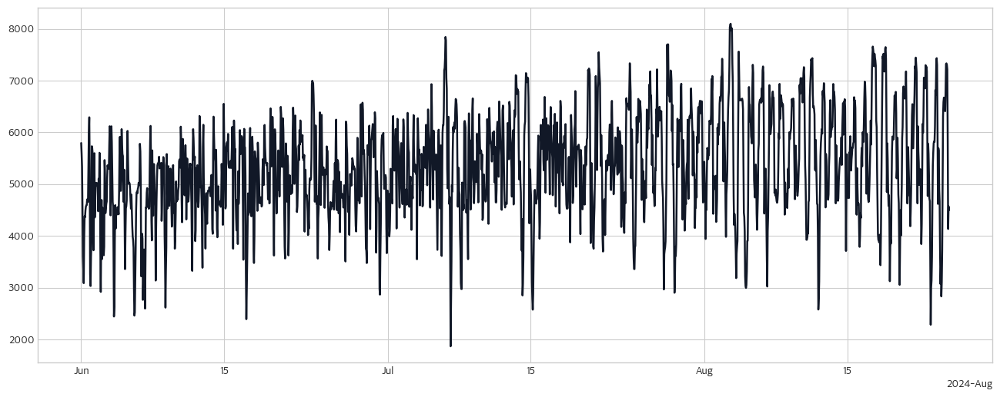

In [650]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.dates import AutoDateLocator, ConciseDateFormatter

# 보기 좋은 색상
COLORS = {
    "actual": "#111827",  # 진한 회흑
    "y_pred": "#2563EB",  # 블루
}

def plot_buildings_y_pred(df,
                          id_col="건물번호",
                          dt_col="datetime",
                          y_col="전력소비량(kWh)",
                          pred_col="y_pred",
                          figsize=(16, 6)):
    for b_id, g in df.groupby(id_col):
        g = g.copy()
        g[dt_col] = pd.to_datetime(g[dt_col], errors="coerce")
        g = g.dropna(subset=[dt_col]).sort_values(dt_col).set_index(dt_col)

        fig, ax = plt.subplots(figsize=figsize)

        # 날짜 축 자동 포맷
        locator = AutoDateLocator()
        formatter = ConciseDateFormatter(locator)
        ax.xaxis.set_major_locator(locator)
        ax.xaxis.set_major_formatter(formatter)

        # 실제값
        ax.plot(g.index, g[y_col],
                color=COLORS["actual"], linewidth=1.8, label="실제")

        # 예측값
        if pred_col in g.columns:
            ax.plot(g.index, g[pred_col],
                    color=COLORS["y_pred_svr_train"], linewidth=1.6,
                    alpha=0.9, label="예측(y_pred)")

        ax.set_title(f"건물번호 {b_id} — 실제 vs 예측(y_pred)", pad=8)
        ax.set_xlabel("시간")
        ax.set_ylabel(y_col)
        ax.legend(loc="upper left", frameon=True).get_frame().set_alpha(0.9)
        ax.grid(True, alpha=0.25)
        plt.tight_layout()
        plt.show()

# 사용 예시
plot_buildings_y_pred(train_check)


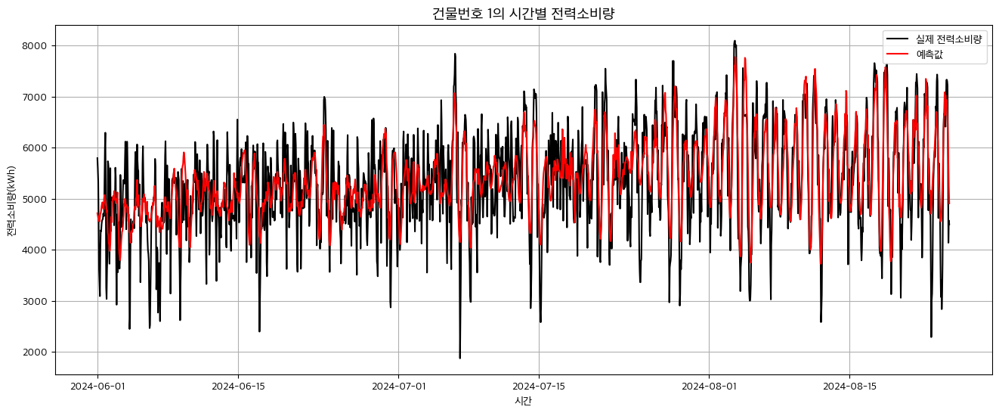

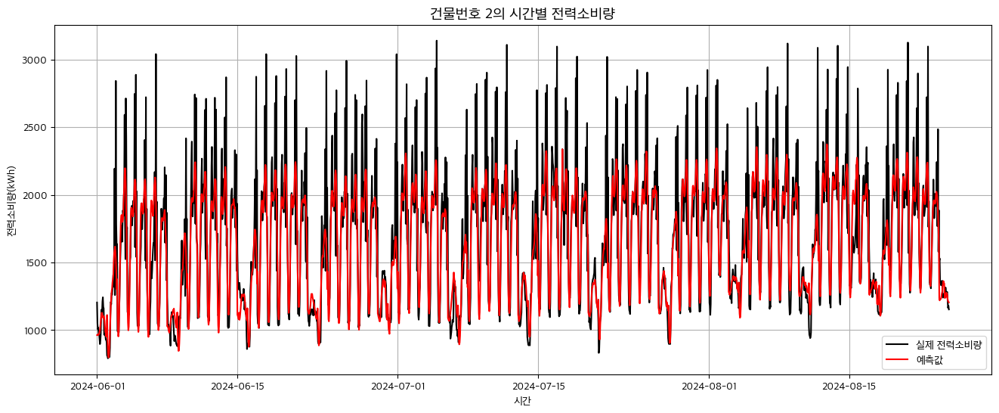

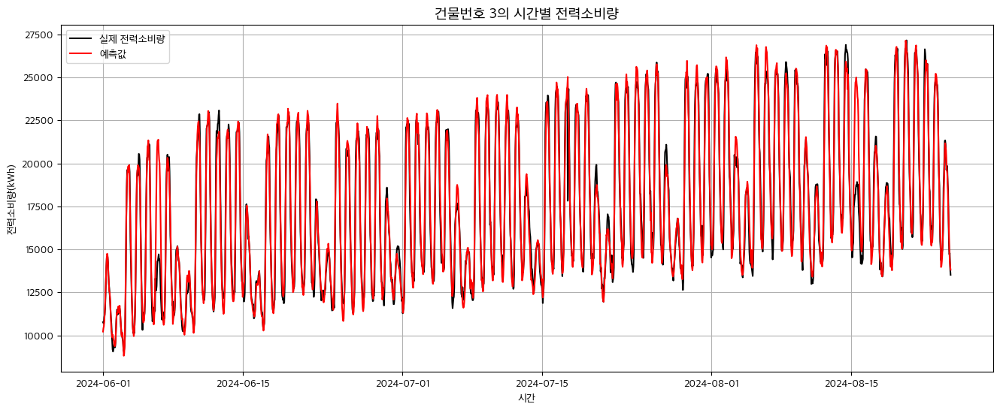

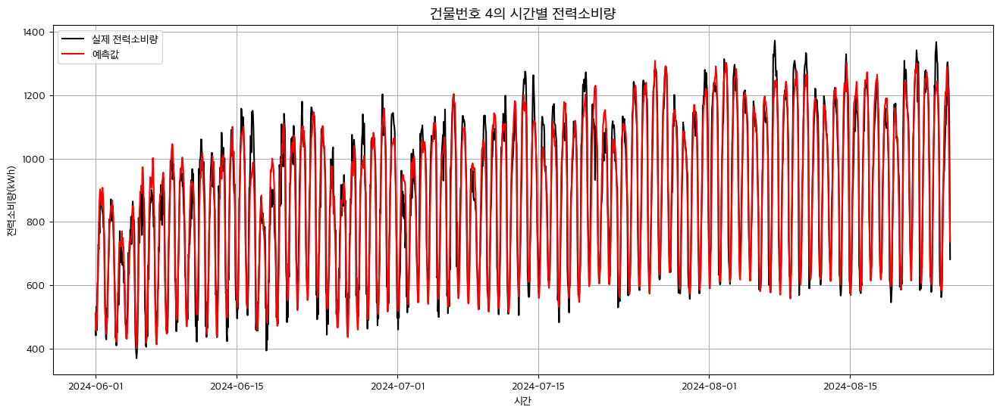

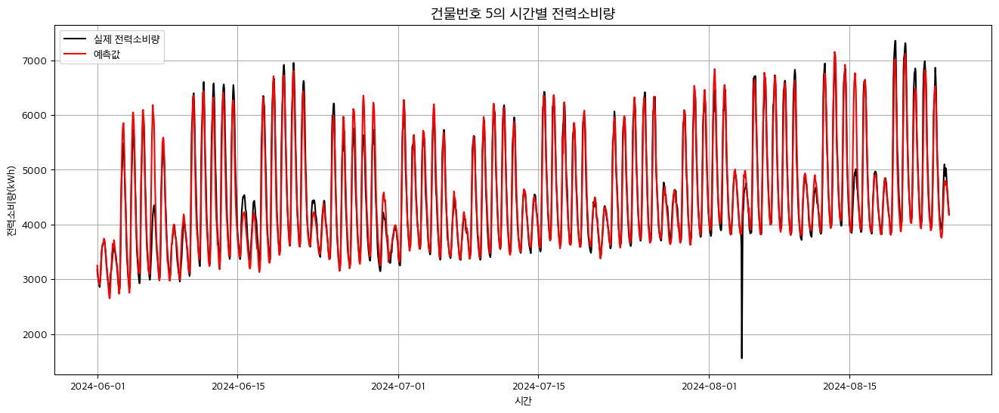

...

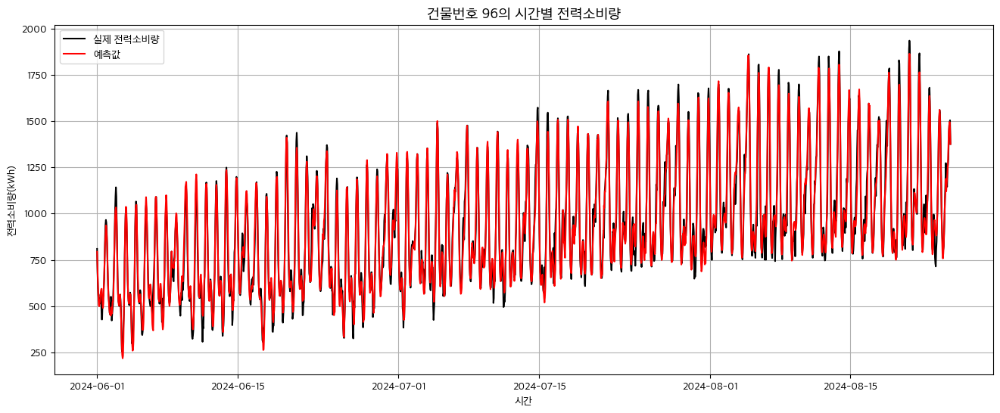

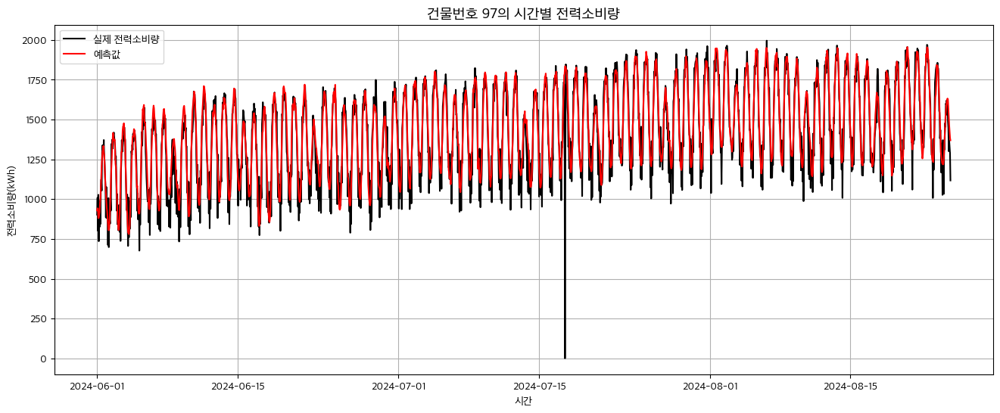

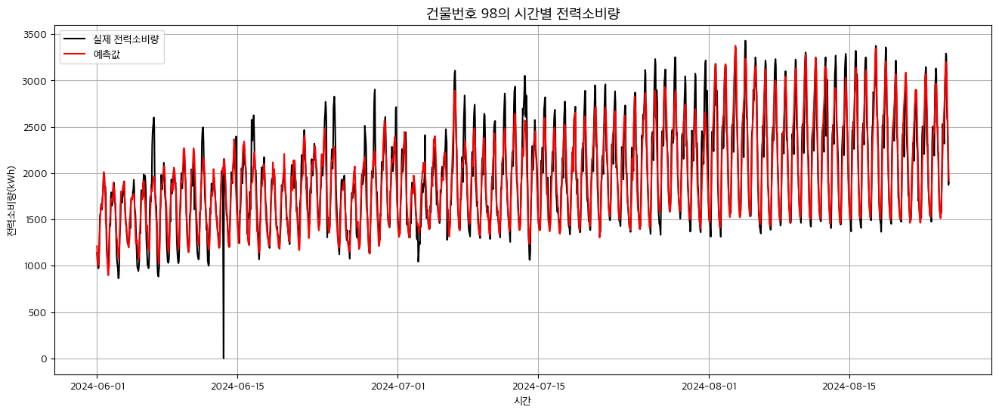

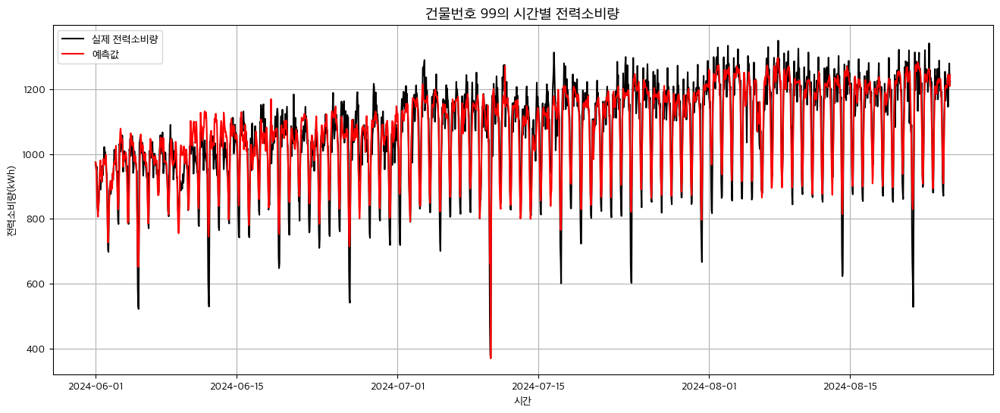

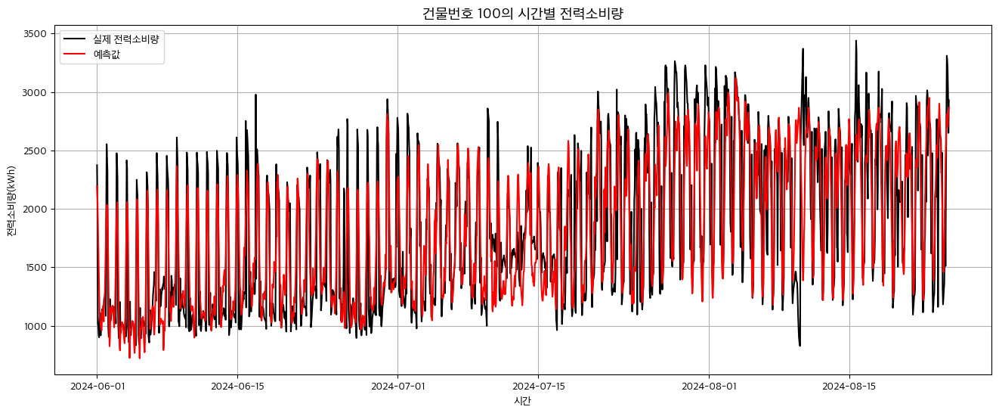

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# 건물 리스트
building_ids = train_check["건물번호"].unique()

for b_id in building_ids:
    # 건물 데이터 선택
    sample_df = train_check[train_check["건물번호"] == b_id].sort_values("datetime")
    
    # 그림
    plt.figure(figsize=(16, 6))
    plt.plot(pd.to_datetime(sample_df["datetime"]),
             sample_df["전력소비량(kWh)"],
             label="실제 전력소비량", color="black")
    
    # 만약 y_pred 컬럼이 있다면 같이 그림
    if "y_pred" in sample_df.columns:
        plt.plot(pd.to_datetime(sample_df["datetime"]),
                 sample_df["y_pred"],
                 label="예측값", color="red")
    
    plt.title(f"건물번호 {b_id}의 시간별 전력소비량", fontsize=14)
    plt.xlabel("시간")
    plt.ylabel("전력소비량(kWh)")
    plt.legend()
    plt.grid(True)
    plt.show()